In [1]:
import numpy as np
import gym
import my_pacman #### Custom environment written to work with gym. Instructions on registration of it are in ReadME file in the same directory

In [2]:
print("Enter size of the grid world (number of rows/number of columns)")
env_size = int(input())
print("Enter number of food pallets")
food_count = int(input())
# print(size)
env = gym.make('my_pacman-v0',size = env_size, num_food = food_count) ### Initialize the custom environment using Gym

Enter size of the grid world (number of rows/number of columns)
5
Enter number of food pallets
1


In [3]:
env.reset()
# env.print()
print("Environment Reset")

Environment Reset


In [4]:
def transform(state): ### Function to transpose the state matrix to a single dimension list to be used during training
    out = []
    for i in range(0,env_size):
        for j in range(0,env_size):
            out.append(state[i][j])
    return out

In [5]:
def map_state(state): ### Function to map the state space to unique integer values
    total = 0
    for i in range(0,env_size*env_size):
        if(state[i]=='-'):
            total+=(4**i)*0
        elif(state[i]=='P'):
            total+=(4**i)*1
        elif(state[i]=='G'):
            total+=(4**i)*2
        elif(state[i]=='*'):
            total+=(4**i)*3
    return total

In [6]:
def epsilon_greedy(Q1,Q2,s): ### Implemetation of epsilon greedy choosing of action
    epsilon = 0.1
    if(s not in Q1):
        Q1.append(s)
        Q2.append(np.random.rand(5))
    ind = Q1.index(s)
    p = np.random.choice([0,1],p = [0.1,0.9])
    if(p==0):
        return np.random.choice([1,2,3,4,5])
    else:
        return (np.argmax(Q2[ind])+1)

In [7]:
def greedy(Q1,Q2,s): ### Implemetation of greedy choosing of action
    if(s not in Q1):
        Q1.append(s)
        Q2.append(np.random.rand(5))
    ind = Q1.index(s)
    return (np.argmax(Q2[ind])+1)

In [12]:
### Model hyper-parameters
gama = 0.5
alpha = 0.7
noe = 30000 ### Number of epochs

In [13]:
###############
###TRAINING ###
###############

In [14]:
ind_list = []    ### List containing integer mapping of the states
Q = []           ### Q table
r_tot = []       ### List for total food consumption
env.reset()

### Implementation of Q-Learning algorithm 

for i in range(0,noe):
    print("Episode =", i)
    state = env.give_state()
    state_tr = transform(state)
    s = map_state(state_tr)
    a = epsilon_greedy(ind_list,Q,s)
    is_over = 0
    while(is_over!=1):
        state, reward, is_over, count_food = env.act(a)
        ind = ind_list.index(s)
        
        state_tr = transform(state)
        sn = map_state(state_tr)
        an = greedy(ind_list,Q,sn) ## Choosing the next state greedily

        indn = ind_list.index(sn)
        mx = Q[indn][an-1]
        
        Q[ind][a-1] = Q[ind][a-1] + alpha*(reward + gama*mx - Q[ind][a-1])
        s = sn
        a = epsilon_greedy(ind_list,Q,s)
    st, t1 = env.reset()
    print("Food consumed in Episode =",t1,"\n")
    r_tot.append(t1)

Episode = 0
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 6
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 9
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 10
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 11
Collided with upper/lower wall. Game Over
Food consumed

Food consumed in Episode = 0 

Episode = 140
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 141
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 142
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 143
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 144
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 145
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 146
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 147
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 148
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 149
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 150
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 151
Collided with left/right wall. G

Food consumed in Episode = 0 

Episode = 275
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 276
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 277
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 278
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 279
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 280
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 281
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 282
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 283
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 284
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 285
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 286
Collided with left/right wall. Gam

Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 405
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 406
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 407
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 408
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 409
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 410
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 411
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 412
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 413
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 414
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 415
Collided with left/right wall. Game Over
Food consumed in Episo

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 514
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 515
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 516
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 517
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 518
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 519
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 520
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 521
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 522
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 523
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 524
Collided with upper/lower wall. Game Over
Food consumed in E

Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 703
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 704
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 705
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 706
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 707
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 708
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 709
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 710
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 711
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 712
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 713
Collided with left/right wall. Game Over
Food consumed in Episod

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 896
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 897
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 898
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 899
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 900
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 901
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 902
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 903
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 904
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 905
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 906
Collided with upper/lower wall. Game Over
Food consumed in Epis

Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 993
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 994
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 995
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 996
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 997
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 998
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 999
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 1000
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1001
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1002
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1003
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

E

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1170
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1171
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1172
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1173
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1174
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1175
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1176
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1177
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1178
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1179
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1180
Collided with left/right wall. Game Ov

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1331
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 1332
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1333
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1334
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1335
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1336
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1337
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1338
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1339
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1340
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1341
Collided with left/right wall. Game Over
Food consumed i

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1497
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 1498
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1499
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1500
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 1501
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1502
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1503
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1504
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1505
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1506
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 1507
Collided with upper/lower wall. Game Over
Food consumed in Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 1637
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1638
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 1639
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1640
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 1641
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 1642
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1643
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1644
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 1645
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1646
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1647
Collided with upper/lower wall. Game Over
Food consumed in Epis

Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 1769
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1770
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1771
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 1772
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1773
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 1774
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 1775
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 1776
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1777
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1778
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1779
Collided with left/right wall. Game Over
Food consumed

Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 1893
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 1894
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 1895
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 1896
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1897
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 1898
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1899
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1900
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1901
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 1902
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 1903
Collided with upper/lower wall. Game Over
Food con

Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2041
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2042
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2043
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2044
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 2045
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2046
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2047
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2048
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2049
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2050
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2051
Collided with upper/lower wall. Game Over
Food consumed in Episode 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2156
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 2157
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2158
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2159
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2160
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2161
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 2162
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2163
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2164
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2165
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 2166
Collided with left/right wall. Game Over
Food consumed in Episode = 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2295
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2296
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2297
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 2298
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2299
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 2300
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 2301
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 2302
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2303
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2304
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2305
Caught by ghost. Game Over
Food consumed in Episode = 0 

Epis

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2427
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2428
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2429
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2430
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2431
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2432
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2433
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2434
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2435
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 2436
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2437
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2438
Caught b

Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 2524
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2525
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2526
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2527
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2528
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2529
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2530
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2531
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2532
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 2533
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2534
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2535
Collided with upper/low

Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 2659
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2660
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2661
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2662
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2663
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2664
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2665
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 2666
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2667
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2668
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2669
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2670
Caught by ghost. Gam

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 2777
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2778
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2779
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2780
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2781
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2782
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2783
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 2784
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 2785
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2786
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 2787
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode =

Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 2889
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 2890
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 2891
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2892
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2893
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2894
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2895
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2896
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2897
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2898
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2899
Collided with left/right wall. Game Over
Food consumed in Episode = 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2986
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2987
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2988
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2989
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2990
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 2991
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 2992
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 2993
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 2994
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2995
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 2996
Collided with upper/lower wall. Game Over
Food consumed in Episo

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3101
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3102
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 3103
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3104
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3105
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3106
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3107
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 3108
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3109
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3110
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3111
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3245
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3246
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3247
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 3248
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3249
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3250
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3251
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3252
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3253
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3254
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3255
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode =

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3391
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3392
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3393
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3394
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3395
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3396
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3397
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3398
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3399
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3400
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 3401
Caught by ghost. Game Over
Food consumed in Episod

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3509
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 3510
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3511
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3512
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3513
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 3514
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3515
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3516
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 3517
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3518
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3519
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3642
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3643
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3644
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3645
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 3646
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3647
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 3648
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 3649
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3650
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3651
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3652
Collided with upper/lower wall. Game Over
Food consumed in Episode 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3771
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 3772
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3773
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3774
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3775
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3776
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3777
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3778
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 3779
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 3780
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3781
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 3782
Collided with upper/low

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3878
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 3879
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 3880
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3881
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3882
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3883
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 3884
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3885
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3886
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 3887
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 3888
Collided with upper/lower wall. Game Over
Food consumed in Episod

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3988
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3989
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 3990
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 3991
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3992
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3993
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3994
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3995
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 3996
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3997
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 3998
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 

Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4097
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4098
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 4099
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4100
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4101
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4102
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4103
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4104
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4105
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4106
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4107
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4108
Collid

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4209
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 4210
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4211
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4212
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4213
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4214
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 4215
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 4216
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 4217
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 4218
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 4219
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 422

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4319
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4320
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4321
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4322
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4323
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4324
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4325
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4326
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 4327
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 4328
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4329
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4330
Collided w

Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4432
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4433
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4434
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 4435
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4436
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4437
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4438
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4439
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4440
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4441
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4442
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 4443
Caught by ghost. Game Over
Food consu

Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 4539
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 4540
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4541
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4542
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 4543
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 4544
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4545
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 4546
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 4547
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 4548
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4549
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode

Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4644
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4645
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4646
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4647
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4648
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4649
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4650
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4651
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 4652
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4653
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4654
Collided with left/right wall. Game Over
Food consume

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4759
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 4760
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4761
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4762
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4763
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 4764
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 4765
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4766
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4767
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 4768
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4769
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode =

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4858
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4859
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4860
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4861
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4862
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 4863
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 4864
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 4865
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4866
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4867
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 4868
Collided with upper/lower wall. Game Over
Food consu

Episode = 4969
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4970
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4971
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4972
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 4973
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 4974
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 4975
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 4976
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 4977
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 4978
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 4979
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 4980
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 4981
Caught b

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5080
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5081
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 5082
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5083
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5084
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5085
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5086
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5087
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5088
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5089
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5090
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode =

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5177
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 5178
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5179
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5180
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 5181
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5182
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 5183
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5184
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5185
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 5186
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 5187
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episo

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5283
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5284
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5285
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5286
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5287
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5288
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5289
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5290
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5291
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 5292
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5293
Collided with upper/lower wall. Game Over
Food consumed in Episode = 

Food consumed in Episode = 0 

Episode = 5383
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 5384
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5385
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5386
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5387
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5388
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5389
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 5390
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5391
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5392
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5393
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5394
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5395
Collided with upper/

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5489
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5490
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 5491
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5492
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 5493
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 5494
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 5495
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5496
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5497
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5498
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5499
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 5600
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5601
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5602
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5603
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 5604
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5605
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5606
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 5607
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 5608
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 5609
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5610
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5611
Collided with upper/lo

Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 5726
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 5727
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5728
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 5729
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 5730
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 5731
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 5732
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 5733
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 5734
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5735
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 5736
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5737
Caught by ghost. Game Over
Food consumed in Episode

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5851
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5852
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5853
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5854
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5855
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 5856
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 5857
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5858
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 5859
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5860
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5861
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 5862
Colli

Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 5954
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 5955
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5956
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5957
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5958
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 5959
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 5960
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 5961
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 5962
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 5963
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 5964
Caught by ghost. Game Over
Food consumed in Episod

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 6078
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6079
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 6080
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 6081
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 6082
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 6083
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6084
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6085
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6086
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 6087
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6088
Collided with left/right wall. Game Over
Food consumed in Episode = 

Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 6190
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 6191
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 6192
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 6193
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6194
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 6195
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6196
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6197
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6198
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 6199
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6200
Collided with left/right wall. Game Over
Food consu

Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 6315
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6316
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6317
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 6318
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6319
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 6320
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 6321
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6322
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 6323
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 6324
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 6325
Collided with upper/lower wall. Game Over
Food consumed in Episode 

Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 6424
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 6425
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6426
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 6427
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 6428
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6429
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 6430
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 6431
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 6432
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 6433
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 6434
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6435
Collided with upper/lower wall. Game

Food consumed in Episode = 0 

Episode = 6539
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 6540
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 6541
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 6542
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 6543
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6544
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 6545
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6546
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 6547
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 6548
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 6549
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 6550
Collided with left/right wall. Gam

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 6662
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 6663
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6664
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 6665
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 6666
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6667
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6668
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6669
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6670
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6671
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6672
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6673
Collided with left/rig

Food consumed in Episode = 10 

Episode = 6788
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6789
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6790
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 6791
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6792
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6793
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 6794
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 6795
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6796
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6797
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 6798
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 6799
Caught by ghost. Game Over
Food consumed in Epi

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6905
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 6906
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6907
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6908
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 6909
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6910
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 6911
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 6912
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 6913
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 6914
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 6915
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 6916
Collided 

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7020
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7021
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7022
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 7023
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7024
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 7025
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 7026
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 7027
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 7028
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 7029
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7030
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 7031
Collided 

Food consumed in Episode = 2 

Episode = 7141
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 7142
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7143
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 7144
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 7145
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 7146
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7147
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7148
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 7149
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 7150
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 7151
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 7152
Caught by ghost. Game 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7243
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 7244
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7245
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7246
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7247
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7248
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 7249
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 7250
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 7251
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7252
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 7253
Collided with upper/lower wall. Game 

Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7355
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 7356
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7357
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 7358
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7359
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 7360
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7361
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7362
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7363
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7364
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7365
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 7481
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 7482
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7483
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 7484
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7485
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 7486
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 7487
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 7488
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 7489
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7490
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7491
Collided with left/right wall. Game Over
Food consumed in Episode = 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 7589
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 7590
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 7591
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7592
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7593
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 7594
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 7595
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 7596
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7597
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 7598
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 7599
Collided with upper/lower wall. Game Over
Food consumed in Episod

Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 7695
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 7696
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7697
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 7698
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 7699
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7700
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7701
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 7702
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7703
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 7704
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 7705
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 7706
Collided with left/right wall. Game O

Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7811
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7812
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7813
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 7814
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7815
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 7816
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7817
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 7818
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 7819
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7820
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 7821
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 7822
Collided with left/right wall. Game Ov

Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7923
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 7924
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7925
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 7926
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7927
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 7928
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 7929
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 7930
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 7931
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 7932
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 7933
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 7934
Caught by ghost. Game Ov

Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 8041
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 8042
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 8043
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 8044
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8045
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8046
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8047
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8048
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 8049
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8050
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8051
Caught by ghost. Game Over
Food consumed in Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8149
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8150
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8151
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 8152
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 8153
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8154
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8155
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8156
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 8157
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8158
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 8159
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episod

Episode = 8268
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8269
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 8270
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 8271
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 8272
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 8273
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 8274
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 8275
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 8276
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 8277
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8278
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8279
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode =

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8381
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 8382
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8383
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 8384
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8385
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8386
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8387
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8388
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8389
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 8390
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8391
Caught by ghost. Game Over
Food consumed in Episode

Episode = 8487
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 8488
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 8489
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 8490
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 8491
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8492
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8493
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8494
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8495
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8496
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 8497
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 8498
Collided with upper/lower wall. Game Over
Food consu

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8591
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8592
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8593
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 8594
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8595
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 8596
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 8597
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8598
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8599
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 8600
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 8601
Collided with upper/lower wall. Game Over
Food consumed in Episode

Food consumed in Episode = 3 

Episode = 8694
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8695
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8696
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8697
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8698
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 8699
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8700
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8701
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 8702
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 8703
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8704
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8705
Caught by ghost. Gam

Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 8805
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8806
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8807
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 8808
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8809
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 8810
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 8811
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 8812
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 8813
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8814
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 8815
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 8908
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 8909
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8910
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 8911
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 8912
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 8913
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 8914
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 8915
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 8916
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 8917
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 8918
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 8919
Caught by ghost. Game O

Food consumed in Episode = 2 

Episode = 9018
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 9019
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9020
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 9021
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 9022
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 9023
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9024
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 9025
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9026
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9027
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9028
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9029
Colli

Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9130
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9131
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 9132
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9133
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 9134
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9135
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 9136
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 9137
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 9138
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 9139
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 9140
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 9141
Caught by

Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 9229
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 9230
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9231
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 9232
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 9233
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 9234
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9235
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9236
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9237
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 9238
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 9239
Collided with upper/lower wall. Game Over
Food consumed in Episode

Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 9344
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9345
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9346
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 9347
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9348
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9349
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9350
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 9351
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 9352
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9353
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 9354
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9355
Collided with left/rig

Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 9454
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 9455
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9456
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9457
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9458
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 9459
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9460
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9461
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 9462
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9463
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 9464
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 9564
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9565
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 9566
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9567
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 9568
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9569
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 9570
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9571
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 9572
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9573
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 9574
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode =

Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 9694
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9695
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 9696
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 9697
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9698
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 9699
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 9700
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 9701
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 9702
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 9703
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 9704
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 9803
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9804
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 9805
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9806
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 9807
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9808
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 9809
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 9810
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 9811
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 9812
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 9813
Collided with left/right wall. Game Over
Food consumed in Episod

Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 9902
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 9903
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 9904
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 9905
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9906
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 9907
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 9908
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 9909
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 9910
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 9911
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 9912
Collided with upper/lower wall. Game Over
Food consumed in Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 10008
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 10009
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 10010
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 10011
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 10012
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 10013
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 10014
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 10015
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 10016
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10017
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 10018
Collided with upper/lower wall. Game Over
Food consumed in Episode =

Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 10115
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 10116
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 10117
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 10118
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 10119
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 10120
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 10121
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 10122
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 10123
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10124
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 10125
Collided with upper/lower wall. Game Over
Food consumed in Episode = 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 10230
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 10231
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 10232
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 10233
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10234
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 10235
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 10236
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 10237
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 10238
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 10239
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 10240
Collided with upper/lower wall. Game Over

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 10339
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 10340
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 10341
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 10342
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 10343
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 10344
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 10345
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 10346
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 10347
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10348
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10349
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 10350
Collided wi

Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 10441
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 10442
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 10443
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 10444
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 10445
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 10446
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 10447
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 10448
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 10449
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 10450
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 10451
Caught by ghost. Game Over
Food consumed 

Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 10565
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10566
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 10567
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10568
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 10569
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 10570
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 10571
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 10572
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 10573
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 10574
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 10575
Collided with left/right wall. Game Over
Food consumed in Episode = 2 


Episode = 10679
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 10680
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 10681
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10682
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 10683
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 10684
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 10685
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 10686
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 10687
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 10688
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 10689
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10690
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode =

Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 10784
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 10785
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 10786
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 10787
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 10788
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 10789
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 10790
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 10791
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 10792
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 10793
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 10794
Collided with upper/lower wall. Game Ove

Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 10892
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10893
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 10894
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 10895
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 10896
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 10897
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 10898
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 10899
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 10900
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 10901
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 10902
Collided with upper/lower wall. Game Over
Food consumed

Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 11007
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11008
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 11009
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 11010
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 11011
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 11012
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 11013
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 11014
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11015
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11016
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11017
Collided with left/right wall. Game Over
Foo

Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 11105
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 11106
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11107
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 11108
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 11109
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 11110
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 11111
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11112
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11113
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 11114
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 11115
Collided with upper/lower wall. Game Over
Food consumed 

Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 11203
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 11204
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11205
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11206
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 11207
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 11208
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11209
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11210
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 11211
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 11212
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 11213
Collided with upper/lower wall. Game Over
Food consumed

Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 11316
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 11317
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 11318
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 11319
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 11320
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 11321
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 11322
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 11323
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11324
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11325
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 11326
Collided with upper/lower wall. Game Over


Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 11414
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 11415
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 11416
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 11417
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 11418
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 11419
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 11420
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 11421
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 11422
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 11423
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11424
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 11

Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 11511
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 11512
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 11513
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 11514
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 11515
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 11516
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11517
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 11518
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 11519
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11520
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 11521
Collided with left/right wall. Game Over
Food consumed in Episode = 2 


Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11606
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 11607
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11608
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 11609
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11610
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11611
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 11612
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 11613
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11614
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 11615
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 11616
Collided with left/right wall. Game Over
Food consumed in E

Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 11702
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 11703
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11704
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 11705
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11706
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11707
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 11708
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 11709
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 11710
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11711
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 11712
Caught by ghost. Game Over
Food consumed in Episode = 2 


Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 11809
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 11810
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11811
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11812
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 11813
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 11814
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 11815
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 11816
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 11817
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 11818
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 11819
Caught by ghost. Game Over
Food consumed 

Episode = 11908
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 11909
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 11910
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 11911
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 11912
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 11913
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 11914
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 11915
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 11916
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 11917
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 11918
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 11919
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 11

Food consumed in Episode = 0 

Episode = 12016
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 12017
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 12018
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 12019
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 12020
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 12021
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12022
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 12023
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 12024
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12025
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 12026
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 12027
Collided with upper/lo

Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 12117
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 12118
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 12119
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 12120
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 12121
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 12122
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 12123
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 12124
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 12125
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12126
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 12127
Collided with left/right wall. Game Over
Food consumed in

Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 12226
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 12227
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 12228
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 12229
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 12230
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 12231
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12232
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 12233
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 12234
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12235
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 12236
Caught by ghost. Game Over
Food consumed in Episode = 1

Episode = 12333
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 12334
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 12335
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 12336
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 12337
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 12338
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12339
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12340
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12341
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 12342
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12343
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 12344
Collided with upper/lower wall. Game Ove

Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 12440
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 12441
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 12442
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 12443
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 12444
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 12445
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12446
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12447
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 12448
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12449
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 12450
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0

Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 12538
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12539
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 12540
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 12541
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 12542
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 12543
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 12544
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 12545
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 12546
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 12547
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 12548
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 12549
Collided with left/right w

Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 12639
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 12640
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 12641
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 12642
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12643
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 12644
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 12645
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 12646
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 12647
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 12648
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 12649
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12

Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 12739
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 12740
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12741
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 12742
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 12743
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12744
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 12745
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 12746
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 12747
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12748
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 12749
Collided with upper/lower wall. Game Over
Food consumed in Episode =

Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 12838
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 12839
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 12840
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12841
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 12842
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 12843
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 12844
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 12845
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 12846
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 12847
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 12848
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 12849
Collided w

Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 12950
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 12951
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 12952
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 12953
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12954
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 12955
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 12956
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 12957
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 12958
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 12959
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 12960
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 129

Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 13052
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 13053
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 13054
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 13055
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 13056
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 13057
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 13058
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 13059
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 13060
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 13061
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 13062
Collided with upper/lower wall. Game 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 13152
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 13153
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 13154
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 13155
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 13156
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 13157
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 13158
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 13159
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 13160
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 13161
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 13162
Collided with left/right wall. Game Over
Food consumed

Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 13257
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 13258
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 13259
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 13260
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 13261
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 13262
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 13263
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 13264
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 13265
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 13266
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 13267
Collided with upper/lower wall. Game Over

Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 13354
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 13355
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 13356
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 13357
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 13358
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 13359
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 13360
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 13361
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 13362
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 13363
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 13364
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5

Episode = 13458
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 13459
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 13460
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 13461
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 13462
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 13463
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 13464
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 13465
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 13466
Caught by ghost. Game Over
Food consumed in Episode = 19 

Episode = 13467
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 13468
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 13469
Collided with left/right wall. Game Over
Food consumed in Episo

Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 13563
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 13564
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 13565
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 13566
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 13567
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 13568
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 13569
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 13570
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 13571
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 13572
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 13573
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 13574
Collided with left/righ

Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 13673
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 13674
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 13675
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 13676
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 13677
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 13678
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 13679
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 13680
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 13681
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 13682
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 13683
Collided with left/right wall. Game Over


Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 13771
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 13772
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 13773
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 13774
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 13775
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 13776
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 13777
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 13778
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 13779
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 13780
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 13781
Collided with upper/lower wall. Game Over
Food consumed in Episode = 

Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 13868
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 13869
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 13870
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 13871
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 13872
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 13873
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 13874
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 13875
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 13876
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 13877
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 13878
Caught by ghost. Game Over
Food consumed in Episode = 3 


Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 13988
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 13989
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 13990
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 13991
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 13992
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 13993
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 13994
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 13995
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 13996
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 13997
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 13998
Collided with left/right wall. Game Over
Food consumed i

Food consumed in Episode = 3 

Episode = 14084
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 14085
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 14086
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 14087
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 14088
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 14089
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 14090
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 14091
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 14092
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 14093
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 14094
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 1

Episode = 14182
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 14183
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 14184
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 14185
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 14186
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 14187
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 14188
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 14189
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 14190
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 14191
Collided with upper/lower wall. Game Over
Food consumed in Episode = 25 

Episode = 14192
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 14193
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 

Collided with left/right wall. Game Over
Food consumed in Episode = 15 

Episode = 14290
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 14291
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 14292
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 14293
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 14294
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 14295
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 14296
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 14297
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 14298
Caught by ghost. Game Over
Food consumed in Episode = 19 

Episode = 14299
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 14300
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode 

Food consumed in Episode = 0 

Episode = 14402
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 14403
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 14404
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 14405
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 14406
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 14407
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 14408
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 14409
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 14410
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 14411
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 14412
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 14413
Caught by ghost. Game

Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 14499
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 14500
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 14501
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 14502
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 14503
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 14504
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 14505
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 14506
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 14507
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 14508
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 14509
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Food consumed in Episode = 2 

Episode = 14610
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 14611
Collided with upper/lower wall. Game Over
Food consumed in Episode = 17 

Episode = 14612
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 14613
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 14614
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 14615
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 14616
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 14617
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 14618
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 14619
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 14620
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 14621
Collid

Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 14712
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 14713
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 14714
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 14715
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 14716
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 14717
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 14718
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 14719
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 14720
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 14721
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 14722
Collided with left/right wall. Game Over
Food consumed in Episode = 1

Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 14817
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 14818
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 14819
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 14820
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 14821
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 14822
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 14823
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 14824
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 14825
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 14826
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 14827
Collided with upper/lower wall. Game Over
Food consumed in Episode 

Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 14923
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 14924
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 14925
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 14926
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 14927
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 14928
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 14929
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 14930
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 14931
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 14932
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 14933
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 14934
Collided with upper/lower wall. Game 

Food consumed in Episode = 0 

Episode = 15026
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 15027
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 15028
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 15029
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 15030
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 15031
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 15032
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 15033
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 15034
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 15035
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 15036
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 15037
Collided with left/right wall.

Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 15123
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 15124
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 15125
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15126
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 15127
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 15128
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 15129
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 15130
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 15131
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 15132
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 15133
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 1

Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 15228
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 15229
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 15230
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 15231
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 15232
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 15233
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 15234
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 15235
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 15236
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 15237
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 15238
Collided with left/right wall. Game Over
Foo

Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 15328
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 15329
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 15330
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15331
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15332
Caught by ghost. Game Over
Food consumed in Episode = 23 

Episode = 15333
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 15334
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 15335
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 15336
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 15337
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 15338
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 15339
Collided with upper/lower wall. Game 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 26 

Episode = 15437
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 15438
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 15439
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 15440
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 15441
Collided with left/right wall. Game Over
Food consumed in Episode = 15 

Episode = 15442
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 15443
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 15444
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 15445
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 15446
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 15447
Caught by ghost. Game Over
Food consume

Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15545
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 15546
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15547
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 15548
Caught by ghost. Game Over
Food consumed in Episode = 33 

Episode = 15549
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 15550
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 15551
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 15552
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 15553
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 15554
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 15555
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 15

Caught by ghost. Game Over
Food consumed in Episode = 29 

Episode = 15654
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 15655
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 15656
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 15657
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 15658
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 15659
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 15660
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15661
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15662
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15663
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 15664
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 15665
Collided with upper/l

Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 15758
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 15759
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 15760
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 15761
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 15762
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 15763
Collided with left/right wall. Game Over
Food consumed in Episode = 23 

Episode = 15764
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 15765
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 15766
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 15767
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 15768
Collided with upper/lower wall. Game Ove

Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 15861
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 15862
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 15863
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 15864
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 15865
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 15866
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 15867
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 15868
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 15869
Caught by ghost. Game Over
Food consumed in Episode = 17 

Episode = 15870
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 15871
Collided with left/right wall. Game Over
Food consumed in Episode = 1

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 15975
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 15976
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 15977
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 15978
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15979
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 15980
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 15981
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15982
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 15983
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 15984
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 15985
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 16083
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 16084
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 16085
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 16086
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 16087
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 16088
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 16089
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 16090
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 16091
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 16092
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 16093
Collided with upper/lower wall. Game Over
Food consumed in Epis

Food consumed in Episode = 5 

Episode = 16182
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 16183
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 16184
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 16185
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 16186
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 16187
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 16188
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 16189
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 16190
Collided with upper/lower wall. Game Over
Food consumed in Episode = 25 

Episode = 16191
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 16192
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 16193
Collided with upper/l

Episode = 16284
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 16285
Collided with left/right wall. Game Over
Food consumed in Episode = 25 

Episode = 16286
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 16287
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 16288
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 16289
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 16290
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 16291
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 16292
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 16293
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 16294
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 16295
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 16296
Collided

Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 16391
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 16392
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 16393
Caught by ghost. Game Over
Food consumed in Episode = 26 

Episode = 16394
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 16395
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 16396
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 16397
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 16398
Collided with left/right wall. Game Over
Food consumed in Episode = 15 

Episode = 16399
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 16400
Collided with upper/lower wall. Game Over
Food consumed in Episode = 28 

Episode = 16401
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode =

Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 16491
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 16492
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 16493
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 16494
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 16495
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 16496
Collided with left/right wall. Game Over
Food consumed in Episode = 26 

Episode = 16497
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 16498
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 16499
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 16500
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 16501
Collided with upper/lower wall. Game Over
Food consumed in Episod

Collided with left/right wall. Game Over
Food consumed in Episode = 22 

Episode = 16597
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 16598
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 16599
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 16600
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 16601
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 16602
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 16603
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 16604
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 16605
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 16606
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 16607
Collided with left/right wall. Game Over
Food consumed in Episode

Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 16703
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 16704
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 16705
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 16706
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 16707
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 16708
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 16709
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 16710
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 16711
Collided with upper/lower wall. Game Over
Food consumed in Episode = 33 

Episode = 16712
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 16713
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 16714
Caught

Collided with left/right wall. Game Over
Food consumed in Episode = 29 

Episode = 16803
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 16804
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 16805
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 16806
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 16807
Collided with left/right wall. Game Over
Food consumed in Episode = 43 

Episode = 16808
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 16809
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 16810
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 16811
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 16812
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 16813
Collided with upper/lower wall. Game Over
Food consumed 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 22 

Episode = 16904
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 16905
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 16906
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 16907
Caught by ghost. Game Over
Food consumed in Episode = 18 

Episode = 16908
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 16909
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 16910
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 16911
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 16912
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 16913
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 16914
Collided with upper/lower wall. Game Over
Food consumed in Episode 

Food consumed in Episode = 8 

Episode = 17007
Collided with upper/lower wall. Game Over
Food consumed in Episode = 34 

Episode = 17008
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 17009
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 17010
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 17011
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 17012
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 17013
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 17014
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 17015
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 17016
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 17017
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 25 

Episode = 17111
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 17112
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 17113
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 17114
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 17115
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 17116
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 17117
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 17118
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 17119
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 17120
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 17121
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode =

Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 17208
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 17209
Collided with upper/lower wall. Game Over
Food consumed in Episode = 27 

Episode = 17210
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 17211
Collided with left/right wall. Game Over
Food consumed in Episode = 24 

Episode = 17212
Caught by ghost. Game Over
Food consumed in Episode = 16 

Episode = 17213
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 17214
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 17215
Caught by ghost. Game Over
Food consumed in Episode = 44 

Episode = 17216
Caught by ghost. Game Over
Food consumed in Episode = 16 

Episode = 17217
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 17218
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 17219
Co

Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 17308
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 17309
Collided with upper/lower wall. Game Over
Food consumed in Episode = 21 

Episode = 17310
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 17311
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 17312
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 17313
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 17314
Collided with left/right wall. Game Over
Food consumed in Episode = 17 

Episode = 17315
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 17316
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 17317
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 17318
Collided with left/right wall. Game Over
Food consum

Caught by ghost. Game Over
Food consumed in Episode = 36 

Episode = 17412
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 17413
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 17414
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 17415
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 17416
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 17417
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 17418
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 17419
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 17420
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 17421
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 17422
Collided with left/right wall. Game Over
Food consumed in Episo

Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 17509
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 17510
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 17511
Collided with left/right wall. Game Over
Food consumed in Episode = 24 

Episode = 17512
Collided with left/right wall. Game Over
Food consumed in Episode = 22 

Episode = 17513
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 17514
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 17515
Caught by ghost. Game Over
Food consumed in Episode = 17 

Episode = 17516
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 17517
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 17518
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 17519
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 17520
Collided with left/right wall. Game O

Collided with left/right wall. Game Over
Food consumed in Episode = 29 

Episode = 17610
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 17611
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 17612
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 17613
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 17614
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 17615
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 17616
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 17617
Collided with upper/lower wall. Game Over
Food consumed in Episode = 17 

Episode = 17618
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 17619
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 17620
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode =

Episode = 17714
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 17715
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 17716
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 17717
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 17718
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 17719
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 17720
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 17721
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 17722
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 17723
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 17724
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 17725
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode =

Collided with upper/lower wall. Game Over
Food consumed in Episode = 37 

Episode = 17814
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 17815
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 17816
Caught by ghost. Game Over
Food consumed in Episode = 18 

Episode = 17817
Collided with upper/lower wall. Game Over
Food consumed in Episode = 54 

Episode = 17818
Caught by ghost. Game Over
Food consumed in Episode = 70 

Episode = 17819
Collided with upper/lower wall. Game Over
Food consumed in Episode = 17 

Episode = 17820
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 17821
Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 17822
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 17823
Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 17824
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Ep

Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 17922
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 17923
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 17924
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 17925
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 17926
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 17927
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 17928
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 17929
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 17930
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 17931
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 17932
Collided with left/right wall. Game Over
Food consum

Caught by ghost. Game Over
Food consumed in Episode = 39 

Episode = 18026
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 18027
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 18028
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 18029
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 18030
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 18031
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 18032
Caught by ghost. Game Over
Food consumed in Episode = 18 

Episode = 18033
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 18034
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 18035
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 18036
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 18037
Collided 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 18140
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 18141
Collided with upper/lower wall. Game Over
Food consumed in Episode = 60 

Episode = 18142
Collided with upper/lower wall. Game Over
Food consumed in Episode = 31 

Episode = 18143
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 18144
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 18145
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 18146
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 18147
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 18148
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 18149
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 18150
Collided with left/right wall. Game Over
Food consumed in Episode

Caught by ghost. Game Over
Food consumed in Episode = 69 

Episode = 18250
Collided with upper/lower wall. Game Over
Food consumed in Episode = 32 

Episode = 18251
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 18252
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 18253
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 18254
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 18255
Caught by ghost. Game Over
Food consumed in Episode = 18 

Episode = 18256
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 18257
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 18258
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 18259
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 18260
Collided with upper/lower wall. Game Over
Food consumed in Episode = 49 

Ep

Food consumed in Episode = 0 

Episode = 18349
Collided with upper/lower wall. Game Over
Food consumed in Episode = 41 

Episode = 18350
Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 18351
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 18352
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 18353
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 18354
Caught by ghost. Game Over
Food consumed in Episode = 17 

Episode = 18355
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 18356
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 18357
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 18358
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 18359
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 18360
Collided wit

Collided with upper/lower wall. Game Over
Food consumed in Episode = 23 

Episode = 18453
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 18454
Caught by ghost. Game Over
Food consumed in Episode = 25 

Episode = 18455
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 18456
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 18457
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 18458
Collided with upper/lower wall. Game Over
Food consumed in Episode = 33 

Episode = 18459
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 18460
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 18461
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 18462
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 18463
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episo

Episode = 18554
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 18555
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 18556
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 18557
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 18558
Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 18559
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 18560
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 18561
Collided with upper/lower wall. Game Over
Food consumed in Episode = 61 

Episode = 18562
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 18563
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 18564
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 18565
Collided with left/right wall. Game Over
Food consumed in Episo

Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 18655
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 18656
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 18657
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 18658
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 18659
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 18660
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 18661
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 18662
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 18663
Caught by ghost. Game Over
Food consumed in Episode = 28 

Episode = 18664
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 18665
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 18666
Caught by ghost. Game Over
Food co

Collided with upper/lower wall. Game Over
Food consumed in Episode = 23 

Episode = 18755
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 18756
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 18757
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 18758
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 18759
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 18760
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 18761
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 18762
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 18763
Caught by ghost. Game Over
Food consumed in Episode = 19 

Episode = 18764
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 18765
Collided with upper/lower wall. Game Over
Food consumed in Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 18856
Collided with upper/lower wall. Game Over
Food consumed in Episode = 21 

Episode = 18857
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 18858
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 18859
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 18860
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 18861
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 18862
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 18863
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 18864
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 18865
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 18866
Collided with left/right wall. Game Over
Food consumed in Episode =

Caught by ghost. Game Over
Food consumed in Episode = 57 

Episode = 18953
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 18954
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 18955
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 18956
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 18957
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 18958
Caught by ghost. Game Over
Food consumed in Episode = 47 

Episode = 18959
Collided with left/right wall. Game Over
Food consumed in Episode = 33 

Episode = 18960
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 18961
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 18962
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 18963
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 18964
Caug

Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 19050
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 19051
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 19052
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 19053
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 19054
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 19055
Collided with left/right wall. Game Over
Food consumed in Episode = 32 

Episode = 19056
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 19057
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 19058
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 19059
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 19060
Collided with upper/lower wall. Game Over
Food consumed in Episode =

Collided with left/right wall. Game Over
Food consumed in Episode = 65 

Episode = 19156
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 19157
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 19158
Caught by ghost. Game Over
Food consumed in Episode = 38 

Episode = 19159
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 19160
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 19161
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 19162
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 19163
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 19164
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 19165
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 19166
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode 

Episode = 19252
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 19253
Caught by ghost. Game Over
Food consumed in Episode = 30 

Episode = 19254
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 19255
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 19256
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 19257
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 19258
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 19259
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 19260
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 19261
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 19262
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 19263
Collided with left/right wall. Game Over
Food consumed in Episode = 31 

Episo

Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 19354
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 19355
Collided with upper/lower wall. Game Over
Food consumed in Episode = 50 

Episode = 19356
Caught by ghost. Game Over
Food consumed in Episode = 31 

Episode = 19357
Collided with left/right wall. Game Over
Food consumed in Episode = 27 

Episode = 19358
Collided with left/right wall. Game Over
Food consumed in Episode = 15 

Episode = 19359
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 19360
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 19361
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 19362
Collided with left/right wall. Game Over
Food consumed in Episode = 23 

Episode = 19363
Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 19364
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode

Caught by ghost. Game Over
Food consumed in Episode = 60 

Episode = 19455
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 19456
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 19457
Caught by ghost. Game Over
Food consumed in Episode = 18 

Episode = 19458
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 19459
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 19460
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 19461
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 19462
Collided with left/right wall. Game Over
Food consumed in Episode = 32 

Episode = 19463
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 19464
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 19465
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 19466
Caugh

Collided with upper/lower wall. Game Over
Food consumed in Episode = 38 

Episode = 19554
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 19555
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 19556
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 19557
Caught by ghost. Game Over
Food consumed in Episode = 43 

Episode = 19558
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 19559
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 19560
Collided with left/right wall. Game Over
Food consumed in Episode = 48 

Episode = 19561
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 19562
Collided with upper/lower wall. Game Over
Food consumed in Episode = 40 

Episode = 19563
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 19564
Caught by ghost. Game Over
Food con

Collided with left/right wall. Game Over
Food consumed in Episode = 35 

Episode = 19654
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 19655
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 19656
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 19657
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 19658
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 19659
Caught by ghost. Game Over
Food consumed in Episode = 36 

Episode = 19660
Collided with left/right wall. Game Over
Food consumed in Episode = 24 

Episode = 19661
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 19662
Caught by ghost. Game Over
Food consumed in Episode = 37 

Episode = 19663
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 19664
Collided with upper/lower wall. Game Over
Food consumed in Episode = 68 

Episode 

Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 19753
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 19754
Caught by ghost. Game Over
Food consumed in Episode = 48 

Episode = 19755
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 19756
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 19757
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 19758
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 19759
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 19760
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 19761
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 19762
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 19763
Collided with left/right wall. Game Over
Food consumed in Episod

Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 19855
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 19856
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 19857
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 19858
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 19859
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 19860
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 19861
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 19862
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 19863
Collided with left/right wall. Game Over
Food consumed in Episode = 45 

Episode = 19864
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 19865
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 19866
Collided with left/

Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 19957
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 19958
Collided with left/right wall. Game Over
Food consumed in Episode = 22 

Episode = 19959
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 19960
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 19961
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 19962
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 19963
Caught by ghost. Game Over
Food consumed in Episode = 70 

Episode = 19964
Collided with left/right wall. Game Over
Food consumed in Episode = 46 

Episode = 19965
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 19966
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 19967
Collided with upper/lower wall. Game Over
Food consumed in Episode

Caught by ghost. Game Over
Food consumed in Episode = 28 

Episode = 20057
Caught by ghost. Game Over
Food consumed in Episode = 24 

Episode = 20058
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 20059
Collided with left/right wall. Game Over
Food consumed in Episode = 27 

Episode = 20060
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 20061
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 20062
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 20063
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 20064
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 20065
Caught by ghost. Game Over
Food consumed in Episode = 23 

Episode = 20066
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 20067
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 20068
Coll

Collided with upper/lower wall. Game Over
Food consumed in Episode = 41 

Episode = 20156
Collided with upper/lower wall. Game Over
Food consumed in Episode = 54 

Episode = 20157
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 20158
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20159
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20160
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 20161
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 20162
Collided with upper/lower wall. Game Over
Food consumed in Episode = 43 

Episode = 20163
Collided with upper/lower wall. Game Over
Food consumed in Episode = 35 

Episode = 20164
Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 20165
Caught by ghost. Game Over
Food consumed in Episode = 34 

Episode = 20166
Collided with left/right wall. Game Over
Food consumed in Episo

Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 20254
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 20255
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20256
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 20257
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 20258
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 20259
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 20260
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 20261
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 20262
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 20263
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 20264
Caught by ghost. Game Over
Food consumed in Episode = 42 

Episode = 20265
Collid

Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 20358
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 20359
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 20360
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 20361
Collided with upper/lower wall. Game Over
Food consumed in Episode = 60 

Episode = 20362
Caught by ghost. Game Over
Food consumed in Episode = 19 

Episode = 20363
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 20364
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 20365
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 20366
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20367
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 20368
Collided with left/right wall. Game Over
Food consumed in Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 20456
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 20457
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 20458
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 20459
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 20460
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 20461
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 20462
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 20463
Caught by ghost. Game Over
Food consumed in Episode = 16 

Episode = 20464
Collided with upper/lower wall. Game Over
Food consumed in Episode = 52 

Episode = 20465
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 20466
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Epis

Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 20568
Collided with upper/lower wall. Game Over
Food consumed in Episode = 57 

Episode = 20569
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 20570
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 20571
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 20572
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20573
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 20574
Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 20575
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 20576
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 20577
Caught by ghost. Game Over
Food consumed in Episode = 23 

Episode = 20578
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 20579
Colli

Collided with left/right wall. Game Over
Food consumed in Episode = 40 

Episode = 20673
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20674
Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 20675
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20676
Collided with upper/lower wall. Game Over
Food consumed in Episode = 44 

Episode = 20677
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 20678
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 20679
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 20680
Collided with upper/lower wall. Game Over
Food consumed in Episode = 29 

Episode = 20681
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 20682
Collided with left/right wall. Game Over
Food consumed in Episode = 15 

Episode = 20683
Collided with left/right wall. Game

Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 20774
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 20775
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 20776
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 20777
Collided with left/right wall. Game Over
Food consumed in Episode = 44 

Episode = 20778
Collided with upper/lower wall. Game Over
Food consumed in Episode = 35 

Episode = 20779
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 20780
Collided with upper/lower wall. Game Over
Food consumed in Episode = 38 

Episode = 20781
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20782
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 20783
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 20784
Collided with upper/lower wall. Game Over
Food consumed in Episode

Food consumed in Episode = 18 

Episode = 20871
Caught by ghost. Game Over
Food consumed in Episode = 31 

Episode = 20872
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 20873
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 20874
Caught by ghost. Game Over
Food consumed in Episode = 30 

Episode = 20875
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 20876
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 20877
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 20878
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 20879
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 20880
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 20881
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 20882
Collided with upper/lower wal

Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 20970
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 20971
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 20972
Collided with upper/lower wall. Game Over
Food consumed in Episode = 68 

Episode = 20973
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 20974
Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 20975
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 20976
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20977
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 20978
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 20979
Collided with upper/lower wall. Game Over
Food consumed in Episode = 28 

Episode = 20980
Caught by ghost. Game Over
Food consumed in Episode

Collided with left/right wall. Game Over
Food consumed in Episode = 41 

Episode = 21069
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 21070
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 21071
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 21072
Collided with upper/lower wall. Game Over
Food consumed in Episode = 54 

Episode = 21073
Collided with upper/lower wall. Game Over
Food consumed in Episode = 56 

Episode = 21074
Collided with left/right wall. Game Over
Food consumed in Episode = 23 

Episode = 21075
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 21076
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 21077
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 21078
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 21079
Collided with upper/lower wall. Game Over
Food consumed in Episode = 28 

Episo

Caught by ghost. Game Over
Food consumed in Episode = 41 

Episode = 21169
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 21170
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 21171
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 21172
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 21173
Collided with upper/lower wall. Game Over
Food consumed in Episode = 50 

Episode = 21174
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 21175
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 21176
Caught by ghost. Game Over
Food consumed in Episode = 24 

Episode = 21177
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 21178
Caught by ghost. Game Over
Food consumed in Episode = 54 

Episode = 21179
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 21180
Caught by ghost. Ga

Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 21268
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 21269
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 21270
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 21271
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 21272
Collided with upper/lower wall. Game Over
Food consumed in Episode = 39 

Episode = 21273
Caught by ghost. Game Over
Food consumed in Episode = 17 

Episode = 21274
Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 21275
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 21276
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 21277
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 21278
Collided with upper/lower wall. Game Over
Food consumed in Episode = 28 

Episod

Food consumed in Episode = 0 

Episode = 21373
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 21374
Caught by ghost. Game Over
Food consumed in Episode = 20 

Episode = 21375
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 21376
Collided with left/right wall. Game Over
Food consumed in Episode = 37 

Episode = 21377
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 21378
Collided with upper/lower wall. Game Over
Food consumed in Episode = 50 

Episode = 21379
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 21380
Collided with left/right wall. Game Over
Food consumed in Episode = 46 

Episode = 21381
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 21382
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 21383
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 21384
Collided with upper/lower wall. Game Over
Food

Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 21473
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 21474
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 21475
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 21476
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 21477
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 21478
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 21479
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 21480
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 21481
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 21482
Collided with upper/lower wall. Game Over
Food consumed in Episode = 44 

Episode = 21483
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 21484
Collide

Collided with left/right wall. Game Over
Food consumed in Episode = 31 

Episode = 21569
Caught by ghost. Game Over
Food consumed in Episode = 17 

Episode = 21570
Collided with upper/lower wall. Game Over
Food consumed in Episode = 34 

Episode = 21571
Collided with left/right wall. Game Over
Food consumed in Episode = 17 

Episode = 21572
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 21573
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 21574
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 21575
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 21576
Caught by ghost. Game Over
Food consumed in Episode = 28 

Episode = 21577
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 21578
Collided with upper/lower wall. Game Over
Food consumed in Episode = 42 

Episode = 21579
Collided with left/right wall. Game Over
Food c

Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 21675
Caught by ghost. Game Over
Food consumed in Episode = 44 

Episode = 21676
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 21677
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 21678
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 21679
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 21680
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 21681
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 21682
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 21683
Caught by ghost. Game Over
Food consumed in Episode = 16 

Episode = 21684
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 21685
Caught by ghost. Game Over
Food consumed in Episode 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 21 

Episode = 21778
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 21779
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 21780
Collided with left/right wall. Game Over
Food consumed in Episode = 23 

Episode = 21781
Collided with upper/lower wall. Game Over
Food consumed in Episode = 37 

Episode = 21782
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 21783
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 21784
Collided with upper/lower wall. Game Over
Food consumed in Episode = 23 

Episode = 21785
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 21786
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 21787
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 21788
Caught by ghost. Game 

Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 21879
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 21880
Collided with left/right wall. Game Over
Food consumed in Episode = 46 

Episode = 21881
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 21882
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 21883
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 21884
Collided with upper/lower wall. Game Over
Food consumed in Episode = 37 

Episode = 21885
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 21886
Caught by ghost. Game Over
Food consumed in Episode = 30 

Episode = 21887
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 21888
Collided with upper/lower wall. Game Over
Food consumed in Episode = 69 

Episode = 21889
Collided with upper/lower wall. Gam

Food consumed in Episode = 1 

Episode = 21983
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 21984
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 21985
Caught by ghost. Game Over
Food consumed in Episode = 75 

Episode = 21986
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 21987
Collided with upper/lower wall. Game Over
Food consumed in Episode = 50 

Episode = 21988
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 21989
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 21990
Collided with upper/lower wall. Game Over
Food consumed in Episode = 24 

Episode = 21991
Collided with left/right wall. Game Over
Food consumed in Episode = 29 

Episode = 21992
Collided with left/right wall. Game Over
Food consumed in Episode = 36 

Episode = 21993
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 21994
Collided with upper/lower wa

Collided with left/right wall. Game Over
Food consumed in Episode = 42 

Episode = 22081
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 22082
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 22083
Collided with left/right wall. Game Over
Food consumed in Episode = 60 

Episode = 22084
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 22085
Collided with left/right wall. Game Over
Food consumed in Episode = 29 

Episode = 22086
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 22087
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 22088
Caught by ghost. Game Over
Food consumed in Episode = 23 

Episode = 22089
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 22090
Caught by ghost. Game Over
Food consumed in Episode = 53 

Episode = 22091
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 22092
Coll

Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 22187
Caught by ghost. Game Over
Food consumed in Episode = 28 

Episode = 22188
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 22189
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 22190
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 22191
Caught by ghost. Game Over
Food consumed in Episode = 71 

Episode = 22192
Caught by ghost. Game Over
Food consumed in Episode = 25 

Episode = 22193
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 22194
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 22195
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 22196
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 22197
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 22198
Caught by ghost. Game Over
Food consumed in Epi

Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 22293
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 22294
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 22295
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 22296
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 22297
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 22298
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 22299
Collided with left/right wall. Game Over
Food consumed in Episode = 31 

Episode = 22300
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 22301
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 22302
Collided with left/right wall. Game Over
Food consumed in Episode = 30 

Episode = 22303
Collided with left/right wall. Game Over
Food consumed in Episode 

Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 22403
Caught by ghost. Game Over
Food consumed in Episode = 23 

Episode = 22404
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 22405
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 22406
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 22407
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 22408
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 22409
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 22410
Caught by ghost. Game Over
Food consumed in Episode = 25 

Episode = 22411
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 22412
Collided with left/right wall. Game Over
Food consumed in Episode = 23 

Episode = 22413
Caught by ghost. Game Over
Food consumed in Episode = 64 

Episode = 22414
Colli

Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 22506
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 22507
Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 22508
Caught by ghost. Game Over
Food consumed in Episode = 26 

Episode = 22509
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 22510
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 22511
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 22512
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 22513
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 22514
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 22515
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 22516
Collided with left/right wall. Game Over
Food consumed in Episode = 28 

Episode = 22517
Collid

Episode = 22602
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 22603
Collided with left/right wall. Game Over
Food consumed in Episode = 17 

Episode = 22604
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 22605
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 22606
Caught by ghost. Game Over
Food consumed in Episode = 30 

Episode = 22607
Caught by ghost. Game Over
Food consumed in Episode = 39 

Episode = 22608
Collided with upper/lower wall. Game Over
Food consumed in Episode = 43 

Episode = 22609
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 22610
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 22611
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 22612
Caught by ghost. Game Over
Food consumed in Episode = 23 

Episode = 22613
Collided with upper/lower wall. Game Over
Food consumed in Ep

Collided with left/right wall. Game Over
Food consumed in Episode = 55 

Episode = 22704
Collided with upper/lower wall. Game Over
Food consumed in Episode = 34 

Episode = 22705
Collided with left/right wall. Game Over
Food consumed in Episode = 33 

Episode = 22706
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 22707
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 22708
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 22709
Collided with upper/lower wall. Game Over
Food consumed in Episode = 33 

Episode = 22710
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 22711
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 22712
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 22713
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 22714
Collided with upper/lower wall. Game Over
Food c

Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 22808
Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 22809
Caught by ghost. Game Over
Food consumed in Episode = 47 

Episode = 22810
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 22811
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 22812
Collided with upper/lower wall. Game Over
Food consumed in Episode = 22 

Episode = 22813
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 22814
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 22815
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 22816
Caught by ghost. Game Over
Food consumed in Episode = 22 

Episode = 22817
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 22818
Collided with left/right wall. Game Over
Food consumed in Episode = 26 

Episo

Food consumed in Episode = 0 

Episode = 22913
Collided with left/right wall. Game Over
Food consumed in Episode = 37 

Episode = 22914
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 22915
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 22916
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 22917
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 22918
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 22919
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 22920
Collided with left/right wall. Game Over
Food consumed in Episode = 15 

Episode = 22921
Collided with left/right wall. Game Over
Food consumed in Episode = 26 

Episode = 22922
Collided with left/right wall. Game Over
Food consumed in Episode = 67 

Episode = 22923
Collided with left/right wall. Game Over
Food consumed in Episode = 27 

Epis

Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 23016
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 23017
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 23018
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 23019
Collided with left/right wall. Game Over
Food consumed in Episode = 27 

Episode = 23020
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 23021
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 23022
Caught by ghost. Game Over
Food consumed in Episode = 23 

Episode = 23023
Caught by ghost. Game Over
Food consumed in Episode = 24 

Episode = 23024
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 23025
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 23026
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Epis

Collided with upper/lower wall. Game Over
Food consumed in Episode = 26 

Episode = 23115
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 23116
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 23117
Collided with upper/lower wall. Game Over
Food consumed in Episode = 39 

Episode = 23118
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 23119
Collided with upper/lower wall. Game Over
Food consumed in Episode = 73 

Episode = 23120
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 23121
Caught by ghost. Game Over
Food consumed in Episode = 38 

Episode = 23122
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 23123
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 23124
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 23125
Caught by ghost. Game Over
Food consumed in Episode = 12 

Ep

Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 23228
Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 23229
Collided with left/right wall. Game Over
Food consumed in Episode = 56 

Episode = 23230
Collided with left/right wall. Game Over
Food consumed in Episode = 27 

Episode = 23231
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 23232
Collided with upper/lower wall. Game Over
Food consumed in Episode = 34 

Episode = 23233
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 23234
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 23235
Collided with upper/lower wall. Game Over
Food consumed in Episode = 31 

Episode = 23236
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 23237
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 23238
Collided with upper/lower wall. Game Over
Food c

Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 23331
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 23332
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 23333
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 23334
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 23335
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 23336
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 23337
Collided with left/right wall. Game Over
Food consumed in Episode = 35 

Episode = 23338
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 23339
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 23340
Collided with upper/lower wall. Game Over
Food consumed in Episode = 65 

Episode = 23341
Collided with left/right wall. Game Over
Food consumed in Episode =

Caught by ghost. Game Over
Food consumed in Episode = 41 

Episode = 23437
Collided with upper/lower wall. Game Over
Food consumed in Episode = 23 

Episode = 23438
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 23439
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 23440
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 23441
Collided with left/right wall. Game Over
Food consumed in Episode = 36 

Episode = 23442
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 23443
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 23444
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 23445
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 23446
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 23447
Caught by ghost. Game Over
Food consumed in Episode = 37 

Episo

Episode = 23541
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 23542
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 23543
Collided with upper/lower wall. Game Over
Food consumed in Episode = 24 

Episode = 23544
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 23545
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 23546
Caught by ghost. Game Over
Food consumed in Episode = 18 

Episode = 23547
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 23548
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 23549
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 23550
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 23551
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 23552
Collided with left/right wall. Game Over
Food consumed in Epi

Food consumed in Episode = 0 

Episode = 23646
Collided with upper/lower wall. Game Over
Food consumed in Episode = 22 

Episode = 23647
Collided with upper/lower wall. Game Over
Food consumed in Episode = 17 

Episode = 23648
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 23649
Collided with left/right wall. Game Over
Food consumed in Episode = 63 

Episode = 23650
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 23651
Collided with upper/lower wall. Game Over
Food consumed in Episode = 56 

Episode = 23652
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 23653
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 23654
Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 23655
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 23656
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 23657
Co

Collided with left/right wall. Game Over
Food consumed in Episode = 52 

Episode = 23750
Caught by ghost. Game Over
Food consumed in Episode = 53 

Episode = 23751
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 23752
Collided with left/right wall. Game Over
Food consumed in Episode = 24 

Episode = 23753
Collided with left/right wall. Game Over
Food consumed in Episode = 42 

Episode = 23754
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 23755
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 23756
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 23757
Collided with left/right wall. Game Over
Food consumed in Episode = 26 

Episode = 23758
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 23759
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 23760
Collided with left/right wall. Game Over
Food con

Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 23846
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 23847
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 23848
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 23849
Caught by ghost. Game Over
Food consumed in Episode = 47 

Episode = 23850
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 23851
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 23852
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 23853
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 23854
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 23855
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 23856
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 23857
Collid

Episode = 23947
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 23948
Collided with left/right wall. Game Over
Food consumed in Episode = 69 

Episode = 23949
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 23950
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 23951
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 23952
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 23953
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 23954
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 23955
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 23956
Caught by ghost. Game Over
Food consumed in Episode = 33 

Episode = 23957
Collided with upper/lower wall. Game Over
Food consumed in Episode = 39 

Episode = 23958
Collided with left

Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 24044
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 24045
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 24046
Collided with upper/lower wall. Game Over
Food consumed in Episode = 21 

Episode = 24047
Caught by ghost. Game Over
Food consumed in Episode = 70 

Episode = 24048
Collided with left/right wall. Game Over
Food consumed in Episode = 30 

Episode = 24049
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 24050
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 24051
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 24052
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 24053
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 24054
Collided with upper/lower wall. Game Over
Food consumed in Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 24145
Collided with left/right wall. Game Over
Food consumed in Episode = 37 

Episode = 24146
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 24147
Collided with upper/lower wall. Game Over
Food consumed in Episode = 56 

Episode = 24148
Caught by ghost. Game Over
Food consumed in Episode = 17 

Episode = 24149
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 24150
Caught by ghost. Game Over
Food consumed in Episode = 23 

Episode = 24151
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 24152
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 24153
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 24154
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 24155
Caught by ghost. Game Over
Food consumed in Ep

Episode = 24246
Collided with upper/lower wall. Game Over
Food consumed in Episode = 31 

Episode = 24247
Collided with upper/lower wall. Game Over
Food consumed in Episode = 55 

Episode = 24248
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 24249
Caught by ghost. Game Over
Food consumed in Episode = 20 

Episode = 24250
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 24251
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 24252
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 24253
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 24254
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 24255
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 24256
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 24257
Collided with upper/lower wall. Game Over
Food

Food consumed in Episode = 6 

Episode = 24348
Collided with upper/lower wall. Game Over
Food consumed in Episode = 24 

Episode = 24349
Caught by ghost. Game Over
Food consumed in Episode = 25 

Episode = 24350
Collided with left/right wall. Game Over
Food consumed in Episode = 122 

Episode = 24351
Collided with left/right wall. Game Over
Food consumed in Episode = 33 

Episode = 24352
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 24353
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 24354
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 24355
Caught by ghost. Game Over
Food consumed in Episode = 17 

Episode = 24356
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 24357
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 24358
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 24359
Collided with upper/lower wall.

Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 24446
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 24447
Collided with upper/lower wall. Game Over
Food consumed in Episode = 28 

Episode = 24448
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 24449
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 24450
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 24451
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 24452
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 24453
Collided with left/right wall. Game Over
Food consumed in Episode = 41 

Episode = 24454
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 24455
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 24456
Collided with upper/lower wall. Game

Episode = 24541
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 24542
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 24543
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 24544
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 24545
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 24546
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 24547
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 24548
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 24549
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 24550
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 24551
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 24552
Caught b

Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 24654
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 24655
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 24656
Collided with upper/lower wall. Game Over
Food consumed in Episode = 41 

Episode = 24657
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 24658
Collided with left/right wall. Game Over
Food consumed in Episode = 52 

Episode = 24659
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 24660
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 24661
Caught by ghost. Game Over
Food consumed in Episode = 19 

Episode = 24662
Collided with left/right wall. Game Over
Food consumed in Episode = 33 

Episode = 24663
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 24664
Collided with upper/lower wall. Game Over
Food consumed in Episode 

Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 24762
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 24763
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 24764
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 24765
Collided with upper/lower wall. Game Over
Food consumed in Episode = 17 

Episode = 24766
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 24767
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 24768
Collided with upper/lower wall. Game Over
Food consumed in Episode = 33 

Episode = 24769
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 24770
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 24771
Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 24772
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 24872
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 24873
Caught by ghost. Game Over
Food consumed in Episode = 53 

Episode = 24874
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 24875
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 24876
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 24877
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 24878
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 24879
Collided with upper/lower wall. Game Over
Food consumed in Episode = 22 

Episode = 24880
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 24881
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 24882
Collided with left/right wall. Game Over
Food c

Collided with upper/lower wall. Game Over
Food consumed in Episode = 35 

Episode = 24972
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 24973
Collided with left/right wall. Game Over
Food consumed in Episode = 57 

Episode = 24974
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 24975
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 24976
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 24977
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 24978
Collided with left/right wall. Game Over
Food consumed in Episode = 72 

Episode = 24979
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 24980
Collided with upper/lower wall. Game Over
Food consumed in Episode = 22 

Episode = 24981
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 24982
Caught by ghost. Game

Food consumed in Episode = 6 

Episode = 25070
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 25071
Caught by ghost. Game Over
Food consumed in Episode = 29 

Episode = 25072
Caught by ghost. Game Over
Food consumed in Episode = 49 

Episode = 25073
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 25074
Collided with left/right wall. Game Over
Food consumed in Episode = 22 

Episode = 25075
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 25076
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 25077
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 25078
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 25079
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 25080
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 25081
Caught by ghost. Game Over
Food consumed in Episo

Food consumed in Episode = 2 

Episode = 25169
Collided with left/right wall. Game Over
Food consumed in Episode = 36 

Episode = 25170
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 25171
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 25172
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 25173
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 25174
Caught by ghost. Game Over
Food consumed in Episode = 59 

Episode = 25175
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 25176
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 25177
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 25178
Collided with upper/lower wall. Game Over
Food consumed in Episode = 55 

Episode = 25179
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 25180
Collided with left/right wall. Game Over
Food 

Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 25279
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 25280
Collided with left/right wall. Game Over
Food consumed in Episode = 73 

Episode = 25281
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 25282
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 25283
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 25284
Collided with left/right wall. Game Over
Food consumed in Episode = 24 

Episode = 25285
Collided with left/right wall. Game Over
Food consumed in Episode = 25 

Episode = 25286
Caught by ghost. Game Over
Food consumed in Episode = 17 

Episode = 25287
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 25288
Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 25289
Collided with left/right wall. Game Over
Food consumed in Episode 

Food consumed in Episode = 41 

Episode = 25380
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 25381
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 25382
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 25383
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 25384
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 25385
Collided with upper/lower wall. Game Over
Food consumed in Episode = 24 

Episode = 25386
Collided with upper/lower wall. Game Over
Food consumed in Episode = 25 

Episode = 25387
Collided with left/right wall. Game Over
Food consumed in Episode = 27 

Episode = 25388
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 25389
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 25390
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Epi

Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 25478
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 25479
Collided with left/right wall. Game Over
Food consumed in Episode = 31 

Episode = 25480
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 25481
Collided with upper/lower wall. Game Over
Food consumed in Episode = 36 

Episode = 25482
Caught by ghost. Game Over
Food consumed in Episode = 19 

Episode = 25483
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 25484
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 25485
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 25486
Collided with upper/lower wall. Game Over
Food consumed in Episode = 50 

Episode = 25487
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 25488
Collided with left/right wall

Collided with upper/lower wall. Game Over
Food consumed in Episode = 33 

Episode = 25577
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 25578
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 25579
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 25580
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 25581
Collided with upper/lower wall. Game Over
Food consumed in Episode = 22 

Episode = 25582
Collided with left/right wall. Game Over
Food consumed in Episode = 52 

Episode = 25583
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 25584
Collided with left/right wall. Game Over
Food consumed in Episode = 27 

Episode = 25585
Collided with left/right wall. Game Over
Food consumed in Episode = 46 

Episode = 25586
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 25587
Collided with left/right wall. Game 

Food consumed in Episode = 59 

Episode = 25676
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 25677
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 25678
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 25679
Collided with left/right wall. Game Over
Food consumed in Episode = 63 

Episode = 25680
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 25681
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 25682
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 25683
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 25684
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 25685
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 25686
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Epis

Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 25778
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 25779
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 25780
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 25781
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 25782
Collided with upper/lower wall. Game Over
Food consumed in Episode = 23 

Episode = 25783
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 25784
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 25785
Collided with upper/lower wall. Game Over
Food consumed in Episode = 28 

Episode = 25786
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 25787
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 25788
Collided with left/right wall. Game Over
Food consumed in Episode = 33 

Epi

Episode = 25874
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 25875
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 25876
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 25877
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 25878
Collided with upper/lower wall. Game Over
Food consumed in Episode = 31 

Episode = 25879
Collided with upper/lower wall. Game Over
Food consumed in Episode = 17 

Episode = 25880
Caught by ghost. Game Over
Food consumed in Episode = 19 

Episode = 25881
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 25882
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 25883
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 25884
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 25885
Collided with left/

Collided with left/right wall. Game Over
Food consumed in Episode = 32 

Episode = 25979
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 25980
Caught by ghost. Game Over
Food consumed in Episode = 88 

Episode = 25981
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 25982
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 25983
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 25984
Collided with upper/lower wall. Game Over
Food consumed in Episode = 21 

Episode = 25985
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 25986
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 25987
Collided with upper/lower wall. Game Over
Food consumed in Episode = 27 

Episode = 25988
Collided with upper/lower wall. Game Over
Food consumed in Episode = 29 

Episode = 25989
Caught by ghost. Game Over
Food consumed in Episode = 66 

Episo

Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 26080
Caught by ghost. Game Over
Food consumed in Episode = 68 

Episode = 26081
Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 26082
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 26083
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 26084
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 26085
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 26086
Caught by ghost. Game Over
Food consumed in Episode = 16 

Episode = 26087
Collided with left/right wall. Game Over
Food consumed in Episode = 30 

Episode = 26088
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 26089
Collided with upper/lower wall. Game Over
Food consumed in Episode = 23 

Episode = 26090
Collided with upper/lower wall. Game Over
Food co

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 26192
Collided with left/right wall. Game Over
Food consumed in Episode = 35 

Episode = 26193
Caught by ghost. Game Over
Food consumed in Episode = 14 

Episode = 26194
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 26195
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 26196
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 26197
Collided with upper/lower wall. Game Over
Food consumed in Episode = 92 

Episode = 26198
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 26199
Collided with left/right wall. Game Over
Food consumed in Episode = 25 

Episode = 26200
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 26201
Collided with left/right wall. Game Over
Food consumed in Episode = 17 

Episode = 26202
Caught by ghost. Game Over
Food consumed in Epis

Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 26294
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 26295
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 26296
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 26297
Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 26298
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 26299
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 26300
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 26301
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 26302
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 26303
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 26304
Collided with lef

Caught by ghost. Game Over
Food consumed in Episode = 65 

Episode = 26392
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 26393
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 26394
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 26395
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 26396
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 26397
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 26398
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 26399
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 26400
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 26401
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 26402
Caught by ghost. Game Over
Food consumed in Episode = 48 

Episode = 26403
Collided with upper/lower wall. Game Ov

Collided with left/right wall. Game Over
Food consumed in Episode = 102 

Episode = 26491
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 26492
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 26493
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 26494
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 26495
Collided with left/right wall. Game Over
Food consumed in Episode = 8 

Episode = 26496
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 26497
Collided with left/right wall. Game Over
Food consumed in Episode = 45 

Episode = 26498
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 26499
Collided with left/right wall. Game Over
Food consumed in Episode = 19 

Episode = 26500
Collided with left/right wall. Game Over
Food consumed in Episode = 32 

Episode = 26501
Caught by ghost. Game Over
Food consumed in Episode = 52 

Episode 

Episode = 26597
Collided with upper/lower wall. Game Over
Food consumed in Episode = 51 

Episode = 26598
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 26599
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 26600
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 26601
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 26602
Caught by ghost. Game Over
Food consumed in Episode = 18 

Episode = 26603
Collided with upper/lower wall. Game Over
Food consumed in Episode = 35 

Episode = 26604
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 26605
Collided with upper/lower wall. Game Over
Food consumed in Episode = 27 

Episode = 26606
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 26607
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 26608
Collided with upper/lower wall. G

Caught by ghost. Game Over
Food consumed in Episode = 20 

Episode = 26694
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 26695
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 26696
Collided with left/right wall. Game Over
Food consumed in Episode = 17 

Episode = 26697
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 26698
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 26699
Caught by ghost. Game Over
Food consumed in Episode = 19 

Episode = 26700
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 26701
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 26702
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 26703
Collided with left/right wall. Game Over
Food consumed in Episode = 49 

Episode = 26704
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 26798
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 26799
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 26800
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 26801
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 26802
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 26803
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 26804
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 26805
Collided with left/right wall. Game Over
Food consumed in Episode = 23 

Episode = 26806
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 26807
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 26808
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episo

Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 26894
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 26895
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 26896
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 26897
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 26898
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 26899
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 26900
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 26901
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 26902
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 26903
Caught by ghost. Game Over
Food consumed in Episode = 29 

Episode = 26904
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 26905
Collid

Collided with upper/lower wall. Game Over
Food consumed in Episode = 29 

Episode = 26993
Collided with left/right wall. Game Over
Food consumed in Episode = 27 

Episode = 26994
Collided with left/right wall. Game Over
Food consumed in Episode = 58 

Episode = 26995
Caught by ghost. Game Over
Food consumed in Episode = 9 

Episode = 26996
Collided with upper/lower wall. Game Over
Food consumed in Episode = 29 

Episode = 26997
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 26998
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 26999
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 27000
Collided with upper/lower wall. Game Over
Food consumed in Episode = 38 

Episode = 27001
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 27002
Caught by ghost. Game Over
Food consumed in Episode = 76 

Episode = 27003
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episod

Food consumed in Episode = 38 

Episode = 27091
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 27092
Caught by ghost. Game Over
Food consumed in Episode = 29 

Episode = 27093
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 27094
Collided with left/right wall. Game Over
Food consumed in Episode = 21 

Episode = 27095
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 27096
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 27097
Caught by ghost. Game Over
Food consumed in Episode = 31 

Episode = 27098
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 27099
Collided with upper/lower wall. Game Over
Food consumed in Episode = 29 

Episode = 27100
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 27101
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 27102


Collided with upper/lower wall. Game Over
Food consumed in Episode = 28 

Episode = 27194
Collided with left/right wall. Game Over
Food consumed in Episode = 50 

Episode = 27195
Collided with upper/lower wall. Game Over
Food consumed in Episode = 38 

Episode = 27196
Caught by ghost. Game Over
Food consumed in Episode = 31 

Episode = 27197
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 27198
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 27199
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 27200
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 27201
Collided with left/right wall. Game Over
Food consumed in Episode = 88 

Episode = 27202
Collided with left/right wall. Game Over
Food consumed in Episode = 36 

Episode = 27203
Collided with upper/lower wall. Game Over
Food consumed in Episode = 60 

Episode = 27204
Caught by ghost. Game Over
Food consumed in Epi

Episode = 27292
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 27293
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 27294
Collided with left/right wall. Game Over
Food consumed in Episode = 13 

Episode = 27295
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 27296
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 27297
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 27298
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 27299
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 27300
Caught by ghost. Game Over
Food consumed in Episode = 41 

Episode = 27301
Collided with upper/lower wall. Game Over
Food consumed in Episode = 31 

Episode = 27302
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 27303
Collided with upper/lower wall. 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 27396
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 27397
Collided with left/right wall. Game Over
Food consumed in Episode = 35 

Episode = 27398
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 27399
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 27400
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 27401
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 27402
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 27403
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 27404
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 27405
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 27406
Collided with upper/lower wall. Game 

Collided with left/right wall. Game Over
Food consumed in Episode = 22 

Episode = 27506
Caught by ghost. Game Over
Food consumed in Episode = 27 

Episode = 27507
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 27508
Caught by ghost. Game Over
Food consumed in Episode = 28 

Episode = 27509
Collided with upper/lower wall. Game Over
Food consumed in Episode = 29 

Episode = 27510
Caught by ghost. Game Over
Food consumed in Episode = 33 

Episode = 27511
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 27512
Collided with upper/lower wall. Game Over
Food consumed in Episode = 86 

Episode = 27513
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 27514
Caught by ghost. Game Over
Food consumed in Episode = 107 

Episode = 27515
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 27516
Caught by ghost. Game Over
Food consumed in Episode = 31 

Episode = 27517
Collided with

Collided with left/right wall. Game Over
Food consumed in Episode = 58 

Episode = 27608
Collided with upper/lower wall. Game Over
Food consumed in Episode = 21 

Episode = 27609
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 27610
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 27611
Collided with left/right wall. Game Over
Food consumed in Episode = 35 

Episode = 27612
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 27613
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 27614
Collided with left/right wall. Game Over
Food consumed in Episode = 52 

Episode = 27615
Collided with upper/lower wall. Game Over
Food consumed in Episode = 63 

Episode = 27616
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 27617
Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 27618
Collided with left/right wall. Game Over
Food consumed in Episo

Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 27709
Collided with upper/lower wall. Game Over
Food consumed in Episode = 50 

Episode = 27710
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 27711
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 27712
Collided with left/right wall. Game Over
Food consumed in Episode = 15 

Episode = 27713
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 27714
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 27715
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 27716
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 27717
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 27718
Collided with left/right wall. Game Over
Food consumed in Episode = 31 

Episode = 27719
Collided with left/right wall. Game Over
Food consum

Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 27814
Collided with upper/lower wall. Game Over
Food consumed in Episode = 24 

Episode = 27815
Collided with left/right wall. Game Over
Food consumed in Episode = 47 

Episode = 27816
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 27817
Collided with upper/lower wall. Game Over
Food consumed in Episode = 27 

Episode = 27818
Collided with left/right wall. Game Over
Food consumed in Episode = 45 

Episode = 27819
Collided with upper/lower wall. Game Over
Food consumed in Episode = 34 

Episode = 27820
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 27821
Collided with upper/lower wall. Game Over
Food consumed in Episode = 36 

Episode = 27822
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 27823
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 27824
Collided with lef

Episode = 27909
Caught by ghost. Game Over
Food consumed in Episode = 15 

Episode = 27910
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 27911
Collided with left/right wall. Game Over
Food consumed in Episode = 17 

Episode = 27912
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 27913
Collided with upper/lower wall. Game Over
Food consumed in Episode = 12 

Episode = 27914
Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 27915
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 27916
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 27917
Collided with left/right wall. Game Over
Food consumed in Episode = 49 

Episode = 27918
Collided with upper/lower wall. Game Over
Food consumed in Episode = 35 

Episode = 27919
Caught by ghost. Game Over
Food consumed in Episode = 31 

Episode = 27920
Collided with upper/lower wall. Game Over
F

Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 28005
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 28006
Collided with upper/lower wall. Game Over
Food consumed in Episode = 82 

Episode = 28007
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 28008
Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 28009
Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 28010
Caught by ghost. Game Over
Food consumed in Episode = 20 

Episode = 28011
Collided with left/right wall. Game Over
Food consumed in Episode = 17 

Episode = 28012
Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 28013
Caught by ghost. Game Over
Food consumed in Episode = 20 

Episode = 28014
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 28015
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 28016


Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 28102
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 28103
Collided with upper/lower wall. Game Over
Food consumed in Episode = 36 

Episode = 28104
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 28105
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 28106
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 28107
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 28108
Collided with left/right wall. Game Over
Food consumed in Episode = 3 

Episode = 28109
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 28110
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 28111
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 28112
Collided with left/ri

Food consumed in Episode = 0 

Episode = 28199
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 28200
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 28201
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 28202
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 28203
Collided with upper/lower wall. Game Over
Food consumed in Episode = 34 

Episode = 28204
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 28205
Collided with upper/lower wall. Game Over
Food consumed in Episode = 22 

Episode = 28206
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 28207
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 28208
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 28209
Collided with left/right wall. Game Over
Food consumed in Episode = 17 

Episode = 28210
Collided with uppe

Food consumed in Episode = 1 

Episode = 28303
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 28304
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 28305
Collided with left/right wall. Game Over
Food consumed in Episode = 52 

Episode = 28306
Collided with upper/lower wall. Game Over
Food consumed in Episode = 46 

Episode = 28307
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 28308
Collided with upper/lower wall. Game Over
Food consumed in Episode = 51 

Episode = 28309
Collided with left/right wall. Game Over
Food consumed in Episode = 52 

Episode = 28310
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 28311
Collided with left/right wall. Game Over
Food consumed in Episode = 83 

Episode = 28312
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 28313
Collided with left/right wall. Game Over
Food consumed in Episode = 22 

Episode = 28314
Cau

Caught by ghost. Game Over
Food consumed in Episode = 64 

Episode = 28402
Collided with upper/lower wall. Game Over
Food consumed in Episode = 17 

Episode = 28403
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 28404
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 28405
Collided with left/right wall. Game Over
Food consumed in Episode = 15 

Episode = 28406
Caught by ghost. Game Over
Food consumed in Episode = 52 

Episode = 28407
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 28408
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 28409
Collided with left/right wall. Game Over
Food consumed in Episode = 18 

Episode = 28410
Collided with upper/lower wall. Game Over
Food consumed in Episode = 47 

Episode = 28411
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 28412
Caught by ghost. Game Over
Food consumed in Episode = 33 

Ep

Collided with upper/lower wall. Game Over
Food consumed in Episode = 55 

Episode = 28499
Caught by ghost. Game Over
Food consumed in Episode = 30 

Episode = 28500
Collided with left/right wall. Game Over
Food consumed in Episode = 24 

Episode = 28501
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 28502
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 28503
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 28504
Collided with upper/lower wall. Game Over
Food consumed in Episode = 43 

Episode = 28505
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 28506
Caught by ghost. Game Over
Food consumed in Episode = 26 

Episode = 28507
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 28508
Caught by ghost. Game Over
Food consumed in Episode = 52 

Episode = 28509
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 28510
Collided with upper/

Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 28598
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 28599
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 28600
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 28601
Collided with left/right wall. Game Over
Food consumed in Episode = 39 

Episode = 28602
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 28603
Caught by ghost. Game Over
Food consumed in Episode = 38 

Episode = 28604
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 28605
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 28606
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 28607
Collided with upper/lower wall. Game Over
Food consumed in Episode = 11 

Episode = 28608
Collided with upper/lower wall. Gam

Collided with upper/lower wall. Game Over
Food consumed in Episode = 23 

Episode = 28697
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 28698
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 28699
Collided with left/right wall. Game Over
Food consumed in Episode = 29 

Episode = 28700
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 28701
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 28702
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 28703
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 28704
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 28705
Collided with left/right wall. Game Over
Food consumed in Episode = 14 

Episode = 28706
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 28707
Collided with left/right wall. Game Over
Food consume

Caught by ghost. Game Over
Food consumed in Episode = 16 

Episode = 28808
Collided with left/right wall. Game Over
Food consumed in Episode = 32 

Episode = 28809
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 28810
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 28811
Caught by ghost. Game Over
Food consumed in Episode = 10 

Episode = 28812
Collided with upper/lower wall. Game Over
Food consumed in Episode = 29 

Episode = 28813
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 28814
Collided with upper/lower wall. Game Over
Food consumed in Episode = 41 

Episode = 28815
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 28816
Collided with left/right wall. Game Over
Food consumed in Episode = 1 

Episode = 28817
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 28818
Collided with upper/lower wall. Game Over
Food 

Collided with upper/lower wall. Game Over
Food consumed in Episode = 33 

Episode = 28910
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 28911
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 28912
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 28913
Caught by ghost. Game Over
Food consumed in Episode = 26 

Episode = 28914
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 28915
Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 28916
Caught by ghost. Game Over
Food consumed in Episode = 8 

Episode = 28917
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 28918
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode = 28919
Collided with left/right wall. Game Over
Food consumed in Episode = 12 

Episode = 28920
Caught by ghost. Game Over
Food consumed in Episode = 26 

Epis

Food consumed in Episode = 3 

Episode = 29010
Collided with left/right wall. Game Over
Food consumed in Episode = 30 

Episode = 29011
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 29012
Collided with left/right wall. Game Over
Food consumed in Episode = 15 

Episode = 29013
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 29014
Caught by ghost. Game Over
Food consumed in Episode = 28 

Episode = 29015
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 29016
Collided with left/right wall. Game Over
Food consumed in Episode = 43 

Episode = 29017
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 29018
Caught by ghost. Game Over
Food consumed in Episode = 28 

Episode = 29019
Caught by ghost. Game Over
Food consumed in Episode = 20 

Episode = 29020
Collided with left/right wall. Game Over
Food consumed in Episode = 6 

Episode = 29021
Collided with le

Collided with upper/lower wall. Game Over
Food consumed in Episode = 21 

Episode = 29120
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 29121
Caught by ghost. Game Over
Food consumed in Episode = 4 

Episode = 29122
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 29123
Caught by ghost. Game Over
Food consumed in Episode = 23 

Episode = 29124
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 29125
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 29126
Collided with left/right wall. Game Over
Food consumed in Episode = 11 

Episode = 29127
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 29128
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 29129
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 29130
Collided with left/right wall. Game Over
Food consumed in Episode = 2 

Episode

Collided with left/right wall. Game Over
Food consumed in Episode = 100 

Episode = 29221
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 29222
Collided with left/right wall. Game Over
Food consumed in Episode = 9 

Episode = 29223
Caught by ghost. Game Over
Food consumed in Episode = 21 

Episode = 29224
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 29225
Caught by ghost. Game Over
Food consumed in Episode = 7 

Episode = 29226
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 29227
Collided with upper/lower wall. Game Over
Food consumed in Episode = 4 

Episode = 29228
Collided with left/right wall. Game Over
Food consumed in Episode = 37 

Episode = 29229
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 29230
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 29231
Collided with upper/lower wall. Game Over
Food consumed in Episode

Collided with upper/lower wall. Game Over
Food consumed in Episode = 31 

Episode = 29324
Caught by ghost. Game Over
Food consumed in Episode = 3 

Episode = 29325
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 29326
Collided with upper/lower wall. Game Over
Food consumed in Episode = 58 

Episode = 29327
Caught by ghost. Game Over
Food consumed in Episode = 26 

Episode = 29328
Collided with upper/lower wall. Game Over
Food consumed in Episode = 25 

Episode = 29329
Caught by ghost. Game Over
Food consumed in Episode = 51 

Episode = 29330
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 29331
Collided with upper/lower wall. Game Over
Food consumed in Episode = 18 

Episode = 29332
Collided with left/right wall. Game Over
Food consumed in Episode = 7 

Episode = 29333
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 29334
Caught by ghost. Game Over
Food consumed in Episode = 16 

Epi

Episode = 29429
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 29430
Collided with upper/lower wall. Game Over
Food consumed in Episode = 32 

Episode = 29431
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 29432
Collided with left/right wall. Game Over
Food consumed in Episode = 94 

Episode = 29433
Collided with upper/lower wall. Game Over
Food consumed in Episode = 54 

Episode = 29434
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 29435
Collided with upper/lower wall. Game Over
Food consumed in Episode = 21 

Episode = 29436
Collided with upper/lower wall. Game Over
Food consumed in Episode = 6 

Episode = 29437
Collided with left/right wall. Game Over
Food consumed in Episode = 23 

Episode = 29438
Caught by ghost. Game Over
Food consumed in Episode = 5 

Episode = 29439
Collided with left/right wall. Game Over
Food consumed in Episode = 87 

Episode = 29440
Caught by ghost. G

Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 29528
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 29529
Collided with upper/lower wall. Game Over
Food consumed in Episode = 27 

Episode = 29530
Collided with upper/lower wall. Game Over
Food consumed in Episode = 24 

Episode = 29531
Collided with upper/lower wall. Game Over
Food consumed in Episode = 1 

Episode = 29532
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 29533
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Episode = 29534
Collided with upper/lower wall. Game Over
Food consumed in Episode = 19 

Episode = 29535
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 29536
Collided with left/right wall. Game Over
Food consumed in Episode = 5 

Episode = 29537
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 29538
Collided with left/right wall. Gam

Collided with upper/lower wall. Game Over
Food consumed in Episode = 7 

Episode = 29627
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 29628
Collided with upper/lower wall. Game Over
Food consumed in Episode = 17 

Episode = 29629
Collided with upper/lower wall. Game Over
Food consumed in Episode = 21 

Episode = 29630
Collided with upper/lower wall. Game Over
Food consumed in Episode = 16 

Episode = 29631
Caught by ghost. Game Over
Food consumed in Episode = 0 

Episode = 29632
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 29633
Collided with upper/lower wall. Game Over
Food consumed in Episode = 30 

Episode = 29634
Caught by ghost. Game Over
Food consumed in Episode = 12 

Episode = 29635
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 29636
Collided with left/right wall. Game Over
Food consumed in Episode = 4 

Episode = 29637
Collided with left/right wall. Game Over
Food consumed in Episode = 0 

Epis

Collided with left/right wall. Game Over
Food consumed in Episode = 40 

Episode = 29727
Collided with upper/lower wall. Game Over
Food consumed in Episode = 3 

Episode = 29728
Collided with left/right wall. Game Over
Food consumed in Episode = 43 

Episode = 29729
Collided with upper/lower wall. Game Over
Food consumed in Episode = 52 

Episode = 29730
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 29731
Collided with left/right wall. Game Over
Food consumed in Episode = 16 

Episode = 29732
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 29733
Collided with left/right wall. Game Over
Food consumed in Episode = 24 

Episode = 29734
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 29735
Collided with upper/lower wall. Game Over
Food consumed in Episode = 9 

Episode = 29736
Collided with upper/lower wall. Game Over
Food consumed in Episode = 41 

Episode = 29737
Caught by ghost. Game Over
Food co

Collided with upper/lower wall. Game Over
Food consumed in Episode = 53 

Episode = 29829
Collided with upper/lower wall. Game Over
Food consumed in Episode = 8 

Episode = 29830
Collided with upper/lower wall. Game Over
Food consumed in Episode = 40 

Episode = 29831
Collided with upper/lower wall. Game Over
Food consumed in Episode = 15 

Episode = 29832
Collided with upper/lower wall. Game Over
Food consumed in Episode = 17 

Episode = 29833
Caught by ghost. Game Over
Food consumed in Episode = 6 

Episode = 29834
Caught by ghost. Game Over
Food consumed in Episode = 11 

Episode = 29835
Collided with upper/lower wall. Game Over
Food consumed in Episode = 13 

Episode = 29836
Collided with upper/lower wall. Game Over
Food consumed in Episode = 5 

Episode = 29837
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 29838
Collided with left/right wall. Game Over
Food consumed in Episode = 10 

Episode = 29839
Collided with upper/lower wall. Game Over
Fo

Episode = 29928
Collided with upper/lower wall. Game Over
Food consumed in Episode = 70 

Episode = 29929
Caught by ghost. Game Over
Food consumed in Episode = 13 

Episode = 29930
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 29931
Collided with upper/lower wall. Game Over
Food consumed in Episode = 14 

Episode = 29932
Caught by ghost. Game Over
Food consumed in Episode = 2 

Episode = 29933
Collided with upper/lower wall. Game Over
Food consumed in Episode = 20 

Episode = 29934
Collided with upper/lower wall. Game Over
Food consumed in Episode = 2 

Episode = 29935
Caught by ghost. Game Over
Food consumed in Episode = 1 

Episode = 29936
Collided with left/right wall. Game Over
Food consumed in Episode = 20 

Episode = 29937
Collided with upper/lower wall. Game Over
Food consumed in Episode = 0 

Episode = 29938
Collided with upper/lower wall. Game Over
Food consumed in Episode = 10 

Episode = 29939
Collided with upper/lower wall. Game Over
Fo

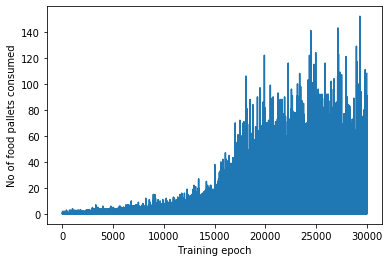

In [16]:
import matplotlib.pyplot as plt
ax = np.arange(len(r_tot))
plt.plot(ax,r_tot)  ## Plotting number of food pellets consumed in each of the epoch
plt.ylabel('No of food pallets consumed')
plt.xlabel('Training epoch')
plt.show()

In [17]:
###############
####TESTING####
###############

In [18]:
ntest = 100
m = [] ### List for total food consumption during testing
env.reset()
for i in range(0,ntest):
    print("Episode =", i)
    state = env.give_state()
    state_tr = transform(state)
    s = map_state(state_tr)
    a = greedy(ind_list,Q,s)
    is_over = 0
    while(is_over!=1):
        ## Comment out the following 2 lines if you do not want to visualise the game at each step. Visualisation will give an intuition into the working of the algorithm.
        env.print()
        print("XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX")
        state, reward, is_over, count_food = env.act(a)
        ind = ind_list.index(s)
        
        state_tr = transform(state)
        sn = map_state(state_tr)
        
        s = sn
        a = greedy(ind_list,Q,s)
    st, t1 = env.reset()
    print("Food consumed in Episode = ",t1,"\n")
    m.append(t1)

Episode = 0
P	-	-	-	-	

-	-	-	-	G	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	G	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G/*	-	

XX

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G/*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	G	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	*	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	P	-	-	G	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXX

-	-	-	G	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	G	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
Caught by ghost. Game Over
Food consumed in Episode 243 

Episode = 1
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

*	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	*	

XXXX

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XX

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G/*	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

XXXX

-	-	-	*	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	G	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXX

G	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G/*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

*	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

*	-	-	-	G	

XXXX

-	-	-	-	-	

-	*	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	G	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G/*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	G	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G	-	

-	-	*	-	

-	-	*	-	-	

-	-	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	*	



-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	G	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	*	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

-	-	*	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	G	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

XX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	G	-	-	P	

-	-	-	-	-	

XX

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	P	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	-	

XXXX


-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G/*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	P	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	G	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G/*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	*	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	P	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	P	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXX

G	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX


-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

G	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	G	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	*	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

P	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

XXXX

-	-	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

-	P	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	G	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	P	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	*	-	G	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	G	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	G	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G/*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G/*	-	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	G	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXX

-	-	-	-	G	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	*	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXX

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	P	-	-	-	

XXXX

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	*	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	P	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXX

-	-	-	-	P	

*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXX

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	P	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	G	-	-	

P	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G/*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	*	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

P	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXX

-	-	P	-	-	

*	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

P	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

P	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	G	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G/*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

P	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

XXXX

-	-	-	-	-	

-	G/*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	*	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	*	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

P	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	G	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	G	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	G	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXX

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G/*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	G	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	P	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XX

-	-	-	-	-	

*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

XXXX

-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XX

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	*	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G/*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	*	-	-	-	

-	-	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	*	P	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXX

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXX

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXX

-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XX

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

P	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	G	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	G	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	G	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	*	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	*	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXX

*	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

XX

-	*	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXX

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

G	-	-	-	*	



-	-	-	-	*	

G	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	G	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

*	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

*	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	G	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

G	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	P	G	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

G	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXX

*	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	*	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	*	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

XXXX

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

*	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G/*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	G	

XXXXXXXXXXXXXX

-	-	-	-	-	

-	G	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G/*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	*	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXX

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	P	-	

-	-	-	-	-	



-	-	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXX

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

G	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	*	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G/*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	G	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	*	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	*	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	G	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G/*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	*	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XX

-	G	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G/*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	P	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	G	

-	*	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	*	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	P	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	



-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXX

-	G	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	



-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	*	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	P	-	-	

XXXX

-	-	*	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

P	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	



-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	*	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXX

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	*	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	G	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	

-	P	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	G	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

G/*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	G	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	*	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

P	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXX

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G/*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	


G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	P	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXX

-	*	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

*	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G/*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	*	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXX

P	*	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

*	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

P	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	*	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	P	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	*	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXX

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
Caught by ghost. Game Over
Food consumed in Episode 114 

Episode = 25
P	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	*	

-	-	-	-	-	

XXXX

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G/*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	*	-	

XXXXXXXXXXXXXX

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	P	

*	-	-	-	-	

-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	*	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	G	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	P	

XXXXXXXXXXXXXXXX


-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXX

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G/*	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XX

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXX

-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXX


-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	P	G	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	*	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

*	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXX

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

XXXX

-	-	-	-	-	

G	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXX

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	*	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	G	-	

-	-	-	-	-	

XX

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	*	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	G	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XX


-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	G/*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	-	-	-	*	

-	-	-	-	-	

XXXX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXX

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXX

-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	*	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	*	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	G	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G/*	

XX

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	*	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	P	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	*	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

XXXX

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXX

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
Caught by ghost. Game Over
Food consumed in Episode 944 

Episode = 28
P	-	-	-	-	

*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	G/*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XX

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

G	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G/*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	G	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

G	-	*	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

G	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	G	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	G	

-	-	-	-	-	

XX

*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XX

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	G	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	G	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXX

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	G	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

*	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

P	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX


-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	*	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	G	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	G	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

G	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXX

-	-	-	-	-	

*	-	-	G	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	G	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	P	

-	-	-	-	*	

XXXX

-	-	-	-	-	

-	-	-	P	-	

-	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	G	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G/*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	*	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
Collided with upper/lower wall. Game Over
Food consumed in Episode 48 

Episode = 31
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G/*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX


-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	G	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G/*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXX

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	G	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXX

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	G	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G/*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	G	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G/*	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	*	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	*	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	G	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G/*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXX

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

G/*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

*	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

G	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G/*	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
Caught by ghost. Game Over
Food consumed in Episode 617 

Episode = 32
P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

*	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	G	-	

XXXX

-	G	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	G	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	*	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

P	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	G	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

P	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

P	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	P	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXX

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

P	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXX


-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	P	-	

-	*	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G/*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

XX

-	-	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	*	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	G	

-	-	-	-	-	

XXXX

-	G	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

*	-	-	-	G	

XXXX

-	-	-	-	G	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	*	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXX

*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

P	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	*	-	P	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G/*	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	P	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	G	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	*	G	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	P	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	P	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	


-	-	P	-	-	

G	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

*	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

*	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G/*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	G	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	*	



*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

G	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	*	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G/*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	*	

XXXX

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXX

G	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	G	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	G	-	

XX

-	-	-	-	G	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

P	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

-	-	-	G	-	

XX

-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	G	-	-	

XXXX

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G/*	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	P	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G/*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

G	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	



-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXX

*	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	G	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	


*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G/*	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXX

-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

-	-	-	-	-	

XXXX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXX

-	P	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXX

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXX

G	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

XXXX

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XX

*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XX

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G/*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	

G	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

XX

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	G	

XXXX

-	-	P	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	



-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	*	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	G	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXX

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	G	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G/*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	*	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XX

-	-	-	-	*	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	G	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

XXXX

*	-	-	-	G	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

*	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

XX


XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	*	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	*	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	G	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXX

*	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	G	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	*	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

P	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G/*	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G/*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	P	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	G	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	*	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

XXXX

-	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	*	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	P	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	G	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	*	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

P	-	-	-	-	

XXXX

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	*	-	

XXXX

G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXX

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	P	-	-	-	

XXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	*	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	*	-	-	G	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	*	-	

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXX


-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	G	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G/*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	*	

G	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	*	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	G	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	


-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXX

-	-	G	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	*	

-	-	-	-	-	

XXXX

-	-	P	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXX

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	G	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	


-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

*	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	G	-	

XXXX

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXX

-	-	*	-	-	

-	-	P	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXX

-	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G/*	-	-	-	

XXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

XXXX

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

XXXX

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	P	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXX

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	*	

-	-	-	-	P	

-	-	-	-	-	



-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

*	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	G	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	G	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	G	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	G	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	G	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

P	-	-	-	-	



-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G/*	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	P	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
Caught by ghost. Game Over
Food consumed in Episode 149 

Episode = 59
P	-	-	-	-	

G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

G	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	



-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	

-	-	*	-	P	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	P	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	G	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	G	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	P	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

*	G	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	*	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	G	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	*	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	*	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

G	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

G	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXX

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G/*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	P	-	-	

XX

-	G	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G/*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	


-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXX

-	-	-	-	-	

-	-	*	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

G	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

XXXX

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	G	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	P	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

P	G/*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XX

-	-	*	-	-	

-	P	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	G	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G/*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	G	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


-	*	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	G	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	


-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXX

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	


-	-	-	-	-	

*	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	G	-	-	

XXXX

-	-	-	-	*	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	*	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	G	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	P	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXX

*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

P	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	*	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XX


XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	*	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
Caught by ghost. Game Over
Food consumed in Episode 18 

Episode = 68
P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	G	

-	-	-	-	-	

-	G	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	*	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	G	-	

XXXXXXXXXXXXXXXX

-	-	-	-	P	

-	-	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	P	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	


*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	*	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXX

*	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	P	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

XXXX

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

G	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXX

P	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G/*	P	-	-	

XX

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	P	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	P	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

XX

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	P	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	*	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	G	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

XXXX

-	-	-	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	P	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	*	-	



-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	G	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

P	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

*	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

XXXX

-	-	-	-	-	

-	-	P	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XX

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	P	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

P	-	-	*	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

G	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G/*	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXX

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	*	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXX


-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	*	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	*	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXX


-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	P	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XX

-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XX

-	-	G	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	*	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXX

G	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXX

-	*	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXX

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	*	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXX

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	


-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

*	-	-	-	-	

XXXXXXXXXXX

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XX


-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	G	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

P	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

P	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	*	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	G	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	G	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	*	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	P	

-	-	G/*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
Caught by ghost. Game Over
Food consumed in Episode 172 

Episode = 83
P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	G	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

XX


-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	G	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

G	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	*	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	P	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	*	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	G/*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	*	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXX

G	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXX

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	G	

-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	*	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXX

G	-	*	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	P	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

XX

-	-	*	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	P	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	*	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	*	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	

-	G	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	G	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	P	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	*	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	*	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	G	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	G	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

G	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G/*	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXX

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

G	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	G	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

P	G	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	*	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	*	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	*	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXX

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	*	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	G	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	G	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	*	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	P	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	G	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	



-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	G	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	*	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	G	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	*	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	G	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	G	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

P	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	P	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	P	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	G	-	

XXXX

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	G	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	G	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	G	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	*	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

G	-	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	*	

-	-	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	*	G	

-	-	-	-	-	

XXXX

G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXX

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G/*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	*	-	-	

XX

G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

G/*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	P	-	-	-	

XXXXXXXXXXXX

-	-	-	-	G/*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

G	-	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	P	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	*	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	*	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G/*	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	G	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	P	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XX

G	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G/*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G/*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

XXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

-	-	-	G	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

XXXX

-	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXX

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	*	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	*	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	P	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	P	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

-	-	-	-	-	

XXXX

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	*	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	

-	-	-	-	-	

*	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	*	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	*	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	*	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXX

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	*	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G	

-	-	P	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	G	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	-	-	-	-	

P	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	G	-	

-	-	-	-	-	

-	-	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	-	-	

P	-	-	-	-	

-	-	*	-	-	

XXXX

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	G	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	P	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	*	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	G/*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	P	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

G	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	*	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	G	*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	G/*	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	G/*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	G	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	G	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

-	G	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	*	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G/*	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXX

-	-	-	-	-	

-	-	-	-	G	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G/*	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	*	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXX

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	*	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	G	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	-	P	-	-	

-	-	*	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	P	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G/*	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	*	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	*	-	P	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	*	P	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXX

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	G	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XX

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	*	-	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

*	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

-	-	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	*	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	-	P	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	P	-	-	

-	-	-	G/*	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

-	-	-	*	-	

XX

-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	P	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	*	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	*	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

P	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	*	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

XXXX

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	P	G	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	-	-	

G	-	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

P	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

G	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXX

*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	-	-	-	

-	-	P	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	-	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
*	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G/*	-	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

G	-	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	*	-	

-	-	-	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	-	-	

-	-	-	*	-	

-	-	-	P	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

-	-	-	-	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	P	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	P	G	-	

*	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

*	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

*	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	*	-	-	

-	-	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXX

-	-	-	G	-	

-	*	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	*	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	-	-	-	

-	-	-	G	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	-	

-	*	-	-	-	

-	-	G	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

*	P	-	-	-	

-	G	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	G	-	-	-	

-	-	-	-	-	

P	-	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	P	-	-	*	

-	-	-	-	-	

-	-	-	-	G	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	-	-	-	-	

-	-	-	-	-	

-	-	P	-	*	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	P	*	

-	-	-	-	-	

-	-	-	-	G	

XXXX

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	G	

-	-	P	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

G	P	-	-	-	

-	*	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

-	G	-	-	-	

-	P	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	G	-	-	-	

-	P	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

G/*	-	-	-	-	

P	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

G	-	-	-	-	

P	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

*	-	-	-	-	

P	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

P	-	-	-	-	

G	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	*	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	

-	-	-	-	-	

-	*	-	-	-	

-	-	P	-	-	

-	-	-	-	G	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	*	-	-	-	

-	P	-	-	G	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

*	P	-	-	-	

-	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

P	-	-	G	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	G	-	

-	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	G	-	-	

-	-	P	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	-	G	P	-	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	-	

-	G	-	-	P	

-	-	-	-	-	

-	-	-	-	*	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	*	

XXXX

-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	P	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	-	

-	-	-	P	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	G	-	-	

-	-	-	-	-	

-	-	-	-	P	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	-	

-	-	G	-	P	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	*	

-	-	-	-	P	

-	-	-	G	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

*	-	G	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	P	

-	-	-	-	-	

-	-	G	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	-	

-	-	-	-	-	

-	G	-	-	-	

*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	P	-	

-	-	-	-	-	

*	G	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	-	

-	-	-	-	P	

-	-	-	-	-	

G/*	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXX

-	-	G	-	*	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
P	-	-	G	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	G/*	

P	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	-	*	

G	P	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
G	P	-	-	*	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	P	-	*	

G	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	-	-	P	*	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	-	P	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	-	P	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
-	*	P	-	-	

-	-	-	-	-	

-	G	-	-	-	

-	-	-	-	-	

-	-	-	-	-	

XX

In [19]:
print("Average number of food pallets consumed during testing using greedy policy = ", np.mean(np.array(m)))

Average number of food pallets consumed during testing using greedy policy =  181.23
